# AAII Investor Sentiment for Trading

*by The Macro Summary*

This notebook contains research into the predictive performance of AAII Investor sentiment. The idea stems from being a market contrarian, as investors are less likely to buy more if they are already very bullish and less likely to sell more if they are already very bearish, since they then already should have sold everything. 

After initial analysis, a backtest is created. 
The results indicate that using a moving average of investor sentiment spread can be helpful as a regime indicator between asset classes but not for market timing in equities. 

The optimal levels for this indicator is getting bullish when the moving average of the investor sentiment spread gets below 0.3 (really bearish) and becoming cautious or even bearish when the moving average of the investor sentiment spread rises above 0.5.

In [1]:
# Hide the code in jupyter notebook
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')


In [2]:
# Importing required libraries
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import quantstats as qs
from sklearn.linear_model import LinearRegression

# Setting plotting style
plt.style.use('ggplot')
plt.rcParams['figure.dpi'] = 300

In [3]:
# Reading in sentiment data from AAII
df = pd.read_excel('sentiment.xls', skiprows = 3)[1:1814].set_index('Date')

## Part 1: Data Exploration

**Showing data from AAII Investor Sentiment**

In [4]:
# Showing data and data statistics
np.round(df.describe(), 3)

,Bullish,Neutral,Bearish,Total,Mov Avg,Spread,Average,+St. Dev.,- St. Dev.,High,Low,Close
count,1810.000,1810.000,1810.000,1810.000,1796.000,1810.000,1813.000,1813.000,1813.000,1812.000,1812.000,1812.000
mean,0.379,0.315,0.307,1.000,0.379,0.072,0.379,0.479,0.279,1382.277,1345.513,1366.938
std,0.100,0.083,0.095,0.000,0.077,0.177,0.000,0.000,0.000,962.372,935.125,951.927
min,0.120,0.077,0.060,1.000,0.175,-0.540,0.379,0.479,0.279,233.450,223.920,223.920
25%,0.306,0.257,0.240,1.000,0.323,-0.048,0.379,0.479,0.279,655.138,634.045,643.685
50%,0.374,0.314,0.295,1.000,0.377,0.078,0.379,0.479,0.279,1204.235,1173.845,1190.375
75%,0.440,0.370,0.364,1.000,0.431,0.190,0.379,0.479,0.279,1687.668,1637.173,1656.995
max,0.750,0.620,0.703,1.002,0.645,0.629,0.379,0.479,0.279,4818.620,4703.960,4793.060


In [5]:
# Visual plot for S&P500 versus selected variable
def sentiment_analysis(df, var):
    """
        Plots a figure with the S&P500 on top and a selected variable on the bottom.
        df: DataFrame - Data from AAII
        var: String - Name of selected variable
    """
    
    # Set up plot
    fig, ax = plt.subplots(3, figsize=(12, 7), sharex = True, gridspec_kw={'height_ratios': [3, 2, 2]})
    # Main price graph
    ax[0].plot(df['Close'])
    ax[0].set_title('S&P500 Index', fontsize = 12)
    ax[0].set_ylabel('Level')
    # Investor sentiment
    ax[1].plot(df[var], color = 'b', linewidth = 0.5)
    ax[1].set_title(f'{var} AAII Investor Sentiment', fontsize = 12)
    ax[1].set_ylabel('Percentage')
    # Variation in investor sentiment
    ax[2].plot(df[var].pct_change(), color = 'black', linewidth = 0.5, alpha = 0.7)
    ax[2].set_title(f'Change in {var} AAII Investor Sentiment', fontsize = 12)
    ax[2].set_ylabel('Points')
    ax[2].set_xlabel('Time')
    # Title
    plt.suptitle(f'Comparing the S&P500 with the {var} AAII Investor Sentiment.', fontsize = 17, fontweight="bold")
    plt.show()

**Index plotted historically versus the Investor Sentiment**

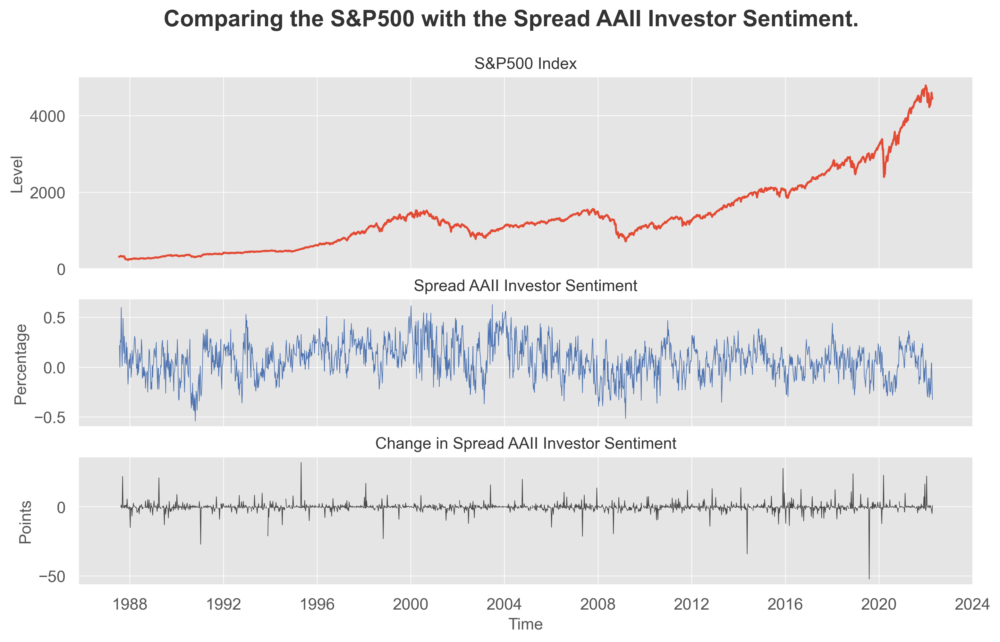

In [6]:
# S&P500 with Sentiment Spread
sentiment_analysis(df, 'Spread')

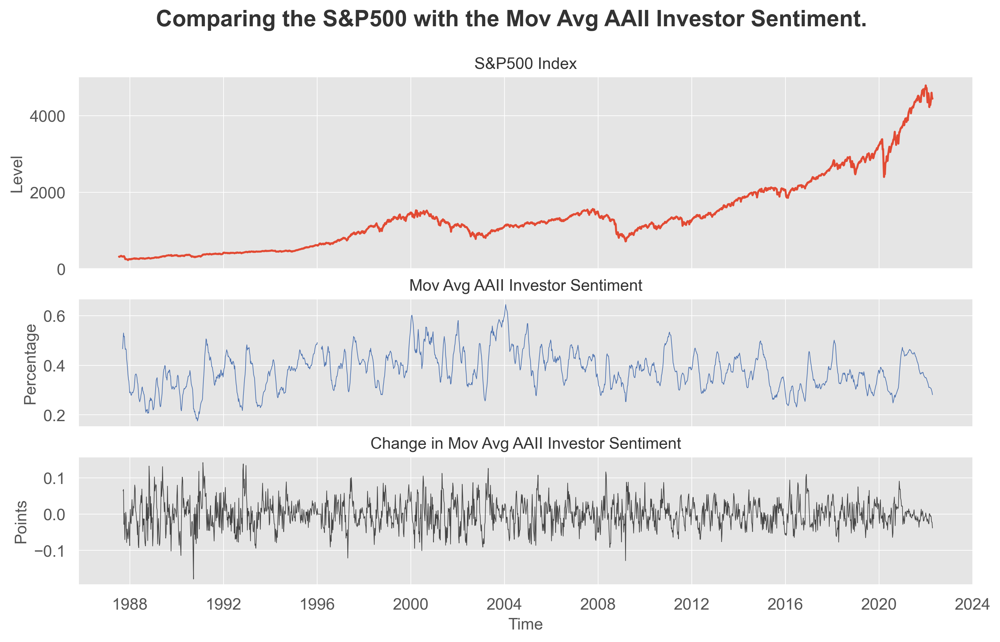

In [7]:
# S&P500 with Sentiment Spread Moving Average
sentiment_analysis(df, 'Mov Avg')

**The sentiment spread against the sentiment level**

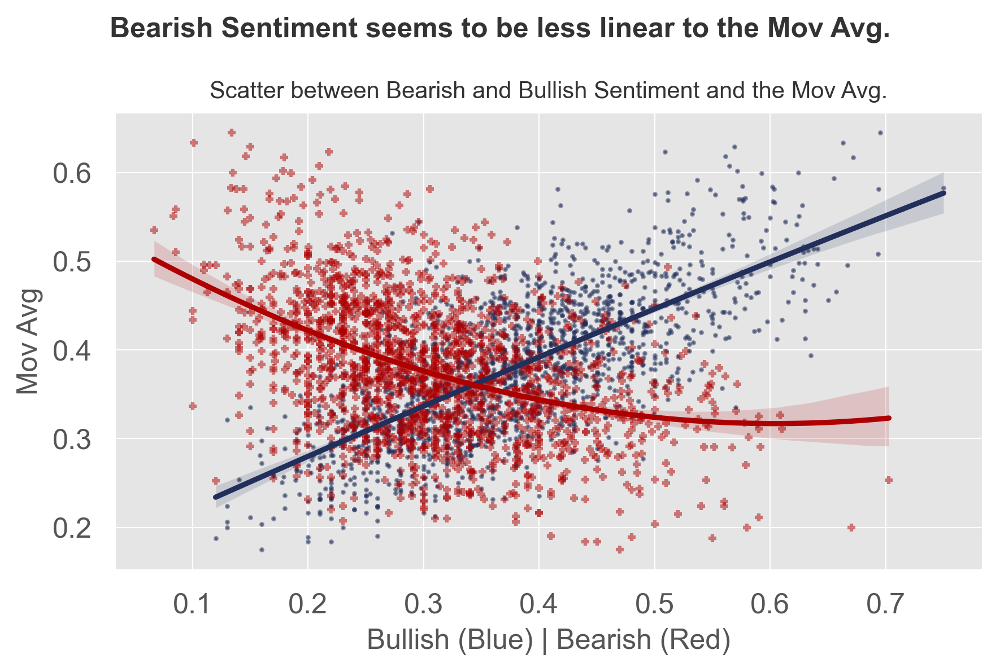

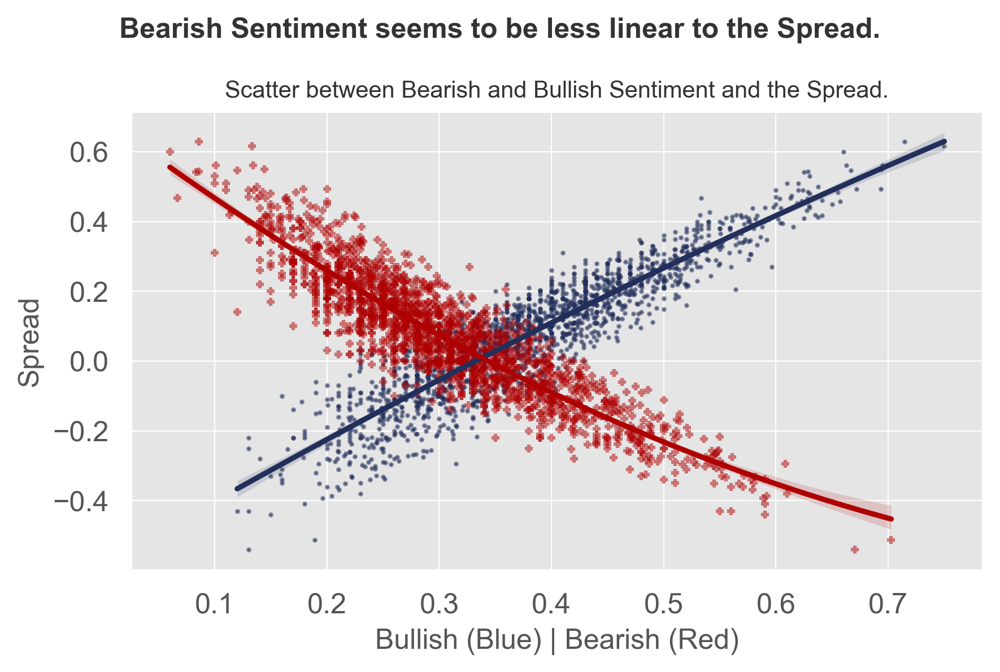

In [8]:
for var in ['Mov Avg', 'Spread']:
    # Plot scatterplot
    _ = sns.regplot(
        y=df[var], 
        x = df['Bullish'], 
        order = 2,
        scatter_kws={'alpha':0.5, 's':5}, 
        marker='.',
        color = '#222f5b'
    )
    _ = sns.regplot(
        y=df[var], 
        x = df['Bearish'],
        order = 2,
        scatter_kws={'alpha':0.5, 's':10},
        marker="+",
        color='#ae0001'
    )
    # Set labels
    _.set(ylabel=var, xlabel='Bullish (Blue) | Bearish (Red)')
    # Set title
    _ = plt.suptitle(f'Bearish Sentiment seems to be less linear to the {var}.', fontweight="bold")
    _ = plt.title(f'Scatter between Bearish and Bullish Sentiment and the {var}.', fontsize = 10)
    _.figure.tight_layout()
    _ = plt.show()

**Relation between one week ahead returns and selected indicator levels**

*Close equals to next weeks S&P500 return*

In [9]:
# Plotting scatter plots with multiple slices between selected variables.
def scatter_plots(df, var1 = 'Close', var2 = 'Mov Avg', rank = 'Bullish', rank_selection = False):
    """
        Plots a scatter plot between returns and a variable with ranks of another variable.
        df (DataFrame): Data from AAII
        var (String): Variable that plots against the returns
        rank (String): Variable that decides the quintile ranking
        rank_selection (Boolean): If True, show only scatter with rank == 1
    """
    
    # Copy data for security
    df2 = df.copy()
    
    # Create quintiles
    df2[rank] = pd.qcut(df2[rank], 5, labels = False)
    
    # Slice data
    df2 = df2[[var1, var2, rank]]
    df2[var1] = df2[var1].pct_change()
    #df2[var2] = df2[var2].pct_change()
    
    # rank selection condition. Show only rank 1
    if rank_selection == True:
        df2 = df2[df2[rank] == 1.0]
    
    # Plot scatterplot
    _ = sns.jointplot(
        y=df2[var1].shift(-1), 
        x = df2[var2], 
        hue=df2[rank], 
        height=8.27
    )
    # Set labels
    _.set_axis_labels(var2, var1, fontsize=12)
    # Set title
    _ = plt.suptitle(f'Scatter between {var1} and {var2} under {rank} partition.', fontweight="bold")
    _.figure.tight_layout()
    _ = plt.show()

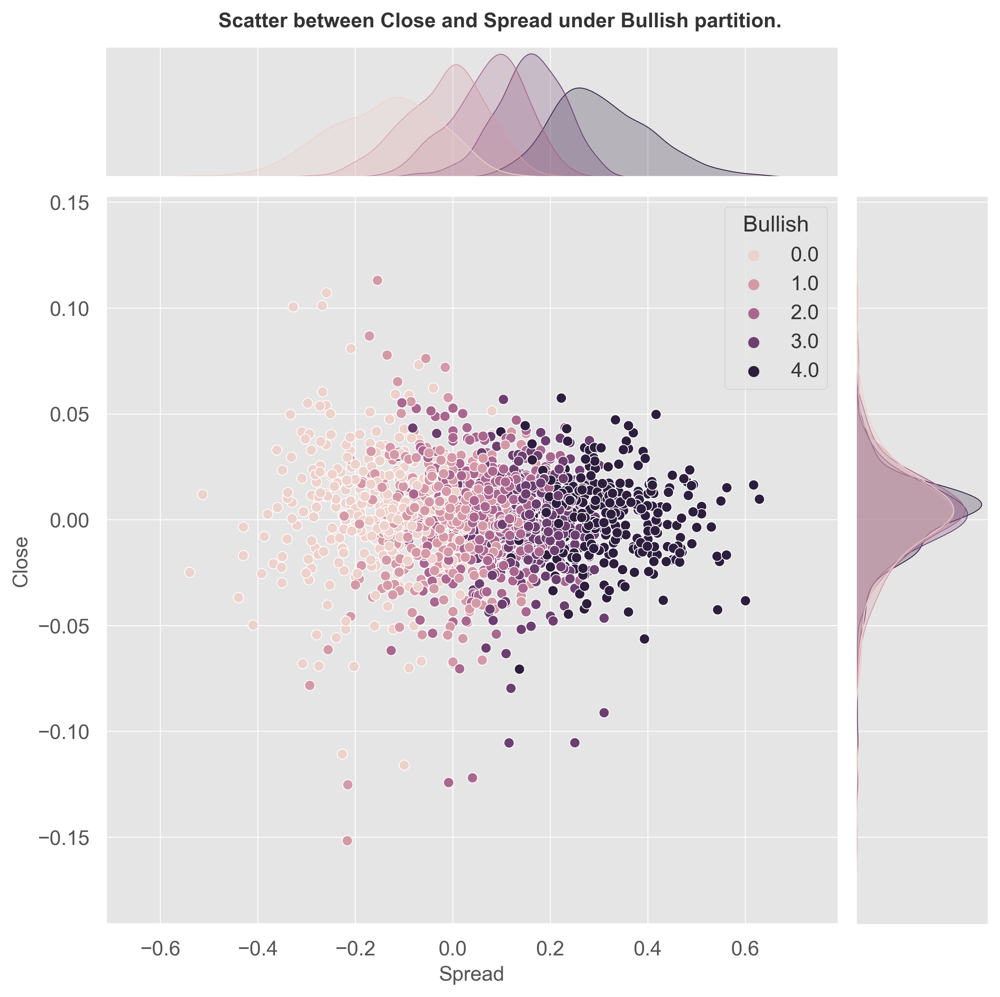

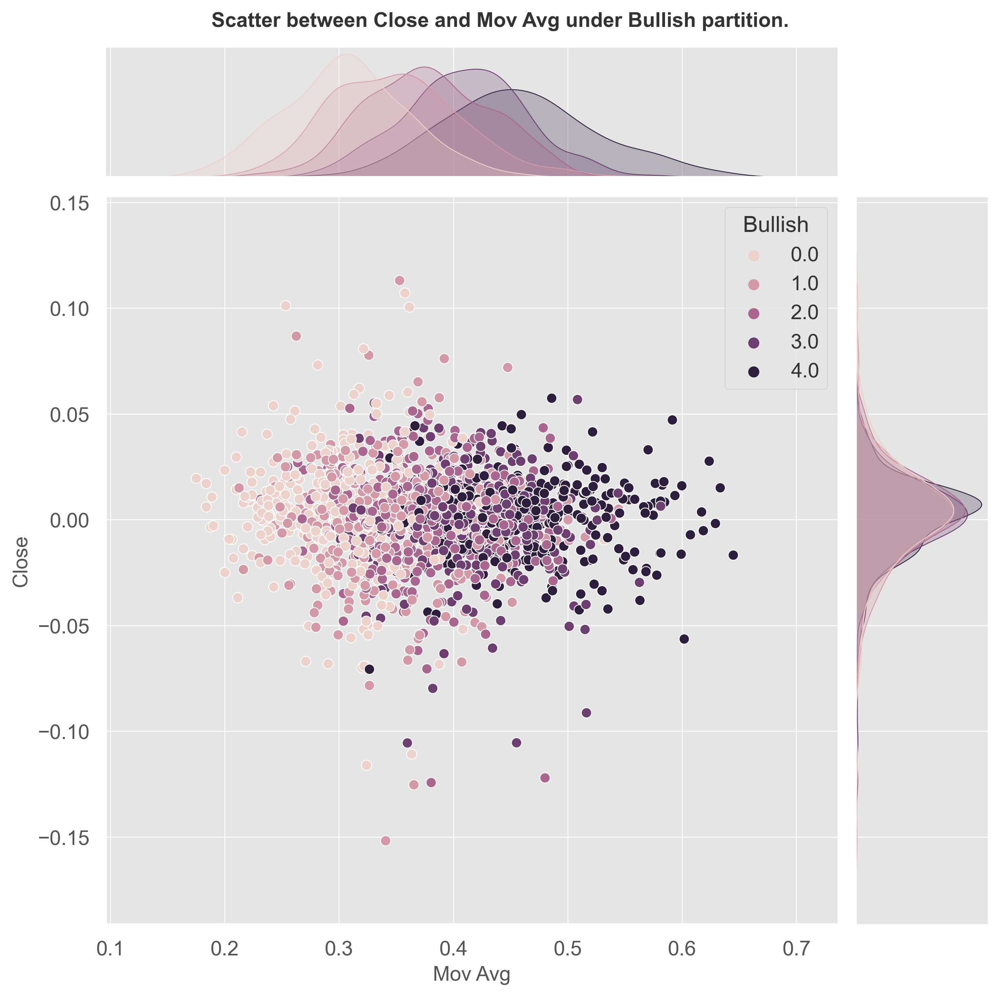

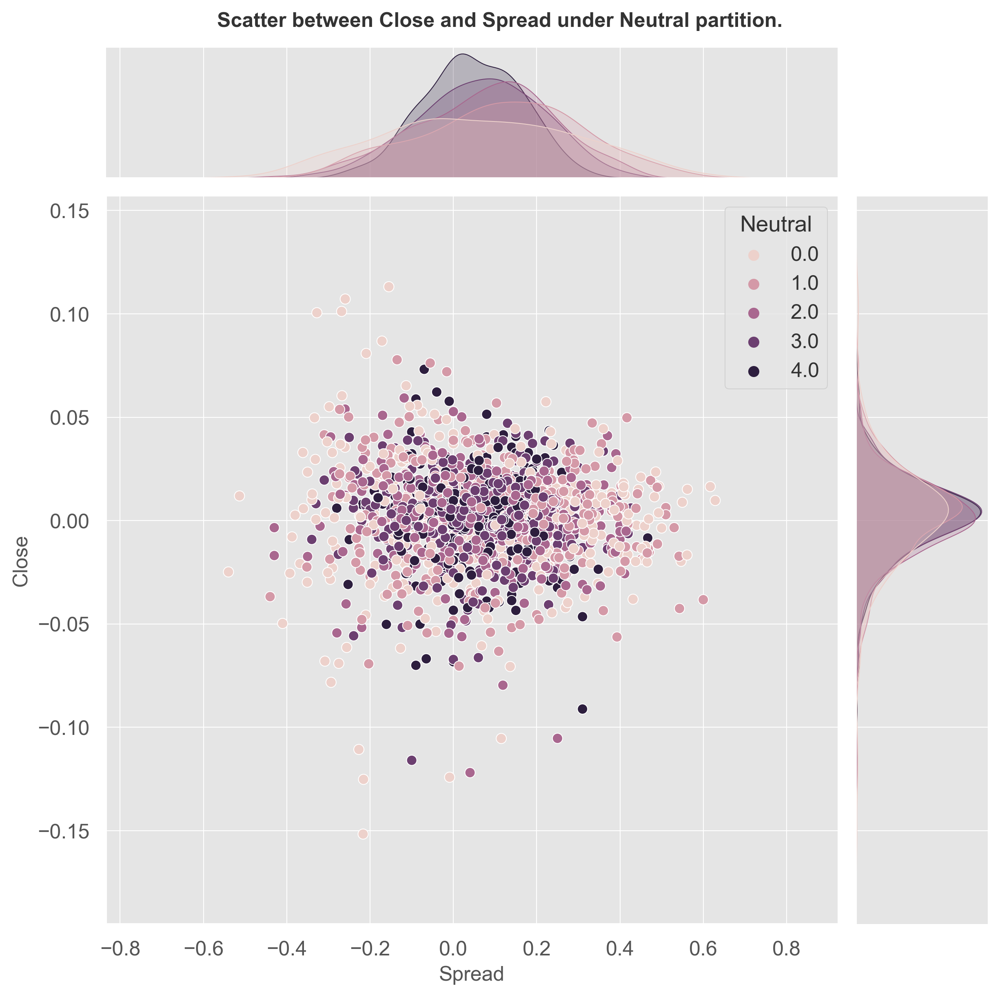

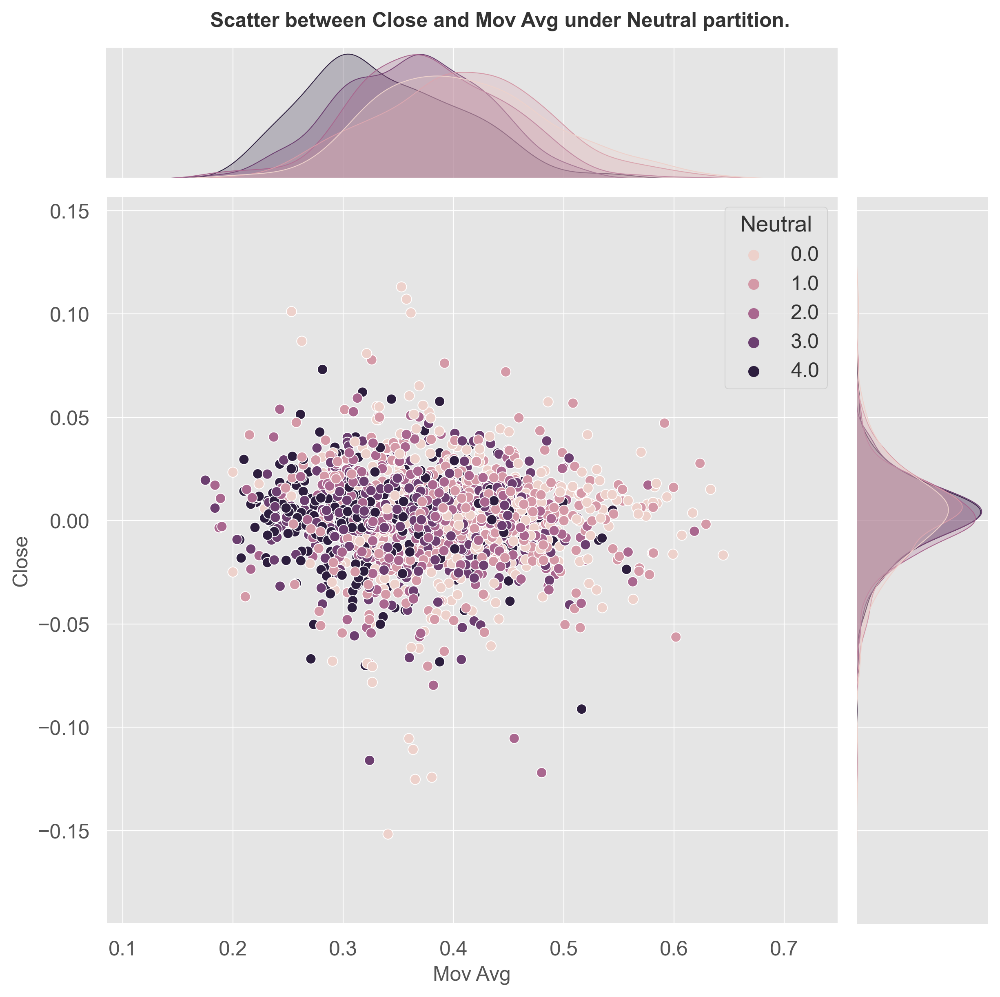

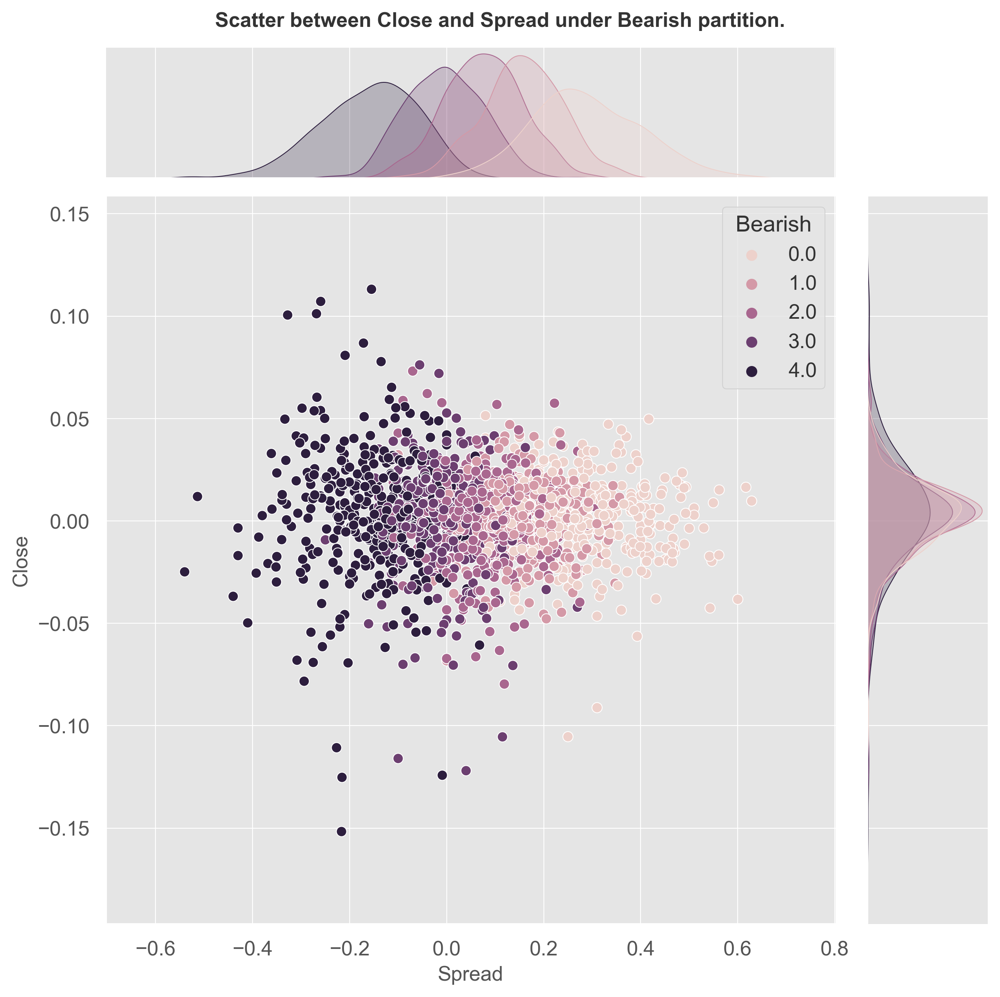

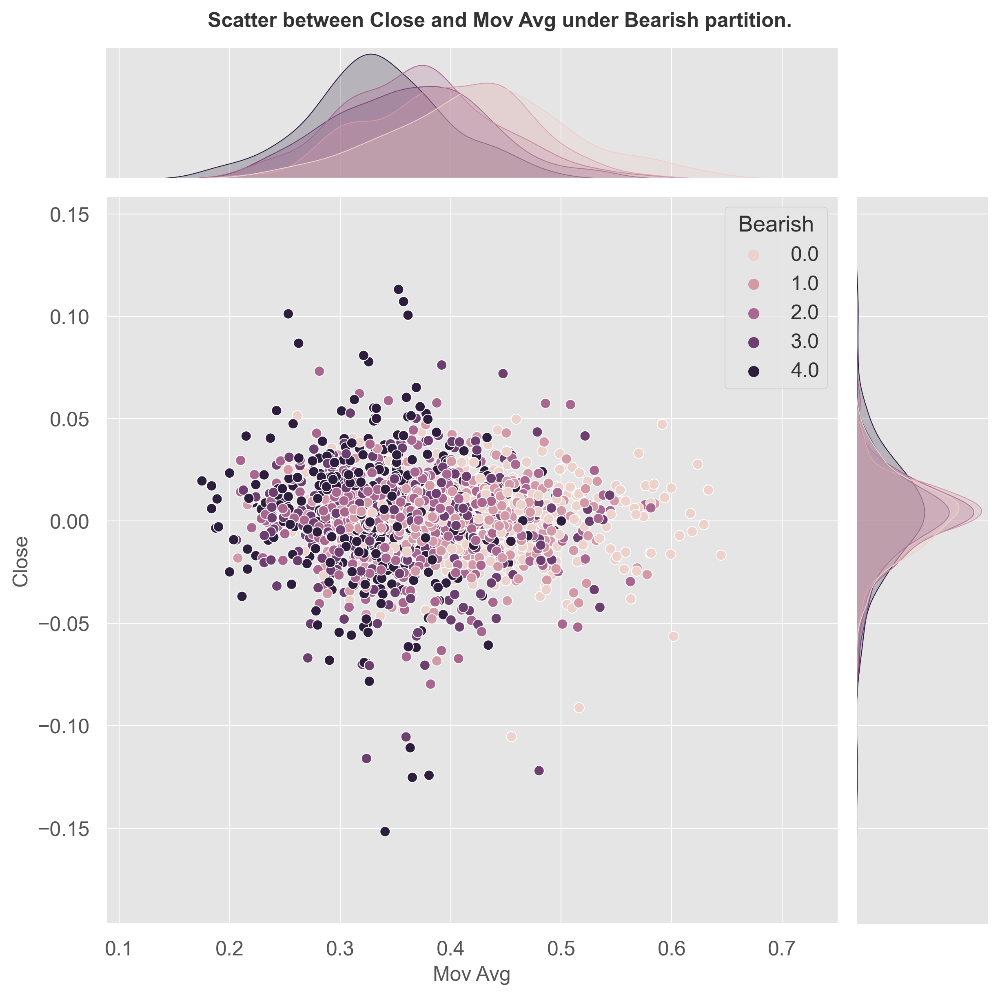

In [10]:
# Run multiple variables against each other.
for rank in ['Bullish', 'Neutral', 'Bearish']:
    for var2 in ['Spread', 'Mov Avg']:
        _ = scatter_plots(df=df, var2=var2, rank=rank)

There is no appearant relation between the moving average and 1 week forward returns, even when slicing the data into partition on different variables.

---

## Part 2: Tradingstrategy

In this section of the research notebook backtests are created to determine the historically optimal level for the indicator to become a regime switch.

In [11]:
# Running a backtest with selective inputs
def backtest(df, long_switch, short_switch, short_value=0, plots = True):
    """
        Runs a backtest of a trading strategy based on AAII data.
        NOT A REPRESENTATION OF HOW THE STRATEGY WILL PERFORM! 
        Does not include any trading costs. 
        Includes overfitting to a certain degree.
        
        df (DataFrame): Data from AAII
        long_switch (float): Level to switch to long regime
        short_switch (float): Level to switch to short regime
        short_value (float): Investment size when a short regime exists.
        plots (boolean): Backtest performance plot yes or no.
        
        Returns dataframe with index dates 
        and columns for S&P500 returns, signals and strategy returns.
    """
    
    # Setting rule conditions
    conditions = [
        (df['Mov Avg'] < long_switch),
        (df['Mov Avg'] > short_switch)
    ]
    # Setting rule choices
    choices = [1, short_value]
    # Calculating signal
    signals = pd.DataFrame(np.select(conditions, choices, default = np.nan), index = df.index, columns = ['Signal']).ffill()
    
    # Calculating strategy returns
    portfolio = pd.concat([df['Close'].pct_change(), signals.shift(1)], axis = 1).iloc[1:]
    portfolio['Strategy'] = portfolio['Close'] * portfolio['Signal']
    
    # Plot
    if plots == True:
        # Set up plot
        fig, ax = plt.subplots(2, 
                               figsize=(10, 5), 
                               sharex=True, 
                               gridspec_kw={'height_ratios': [3, 1]}
                              )
        # Strategy
        ax[0].plot(portfolio['Strategy'].cumsum(), label = f'Strategy: ls: {long_switch}, ss: {short_switch}, sv: {short_value}')
        ax[0].plot(portfolio['Close'].cumsum(), label = 'Benchmark')
        ax[0].legend()
        ax[0].set_ylabel('Returns')
        # Signal
        ax[1].plot(portfolio['Signal'], color = 'black', linewidth = 0.5, label = 'Signal')
        ax[1].set_ylabel('Signal')
        ax[1].set_xlabel('Time')
        # Plotting
        plt.suptitle(f'Trading the S&P500 with the AAII Investor Sentiment as Regime Signal. Parameter {long_switch}, {short_switch}, {short_value}.', fontweight="bold")
        plt.tight_layout()
        plt.show()
    
    # Returns strategy dataframe
    return portfolio

In [12]:
# Create dictionary for all strategies
strategies = {
    'id': [],
    'short_weight': [],
    'long_switch': [],
    'short_switch': [],
    'strat_sharpe': [],
    'bench_sharpe': [],
    '# of signals': []
}
performance = pd.DataFrame()
i = 0

# Running through many variables to optimize for sharpe ratio
# This creates overfitting! Do not use for investment, only for indicator analysis.
for short_weight in [0.5, 0.3, 0, -1]:
    for long_switch in [0.25, 0.3, 0.35, 0.4]:
        for short_switch in [0.45, 0.5, 0.55, 0.6]:
            i += 1
            # Get backtest data
            portfolio = backtest(df['1988-01-01':], long_switch, short_switch, short_weight, plots = False)
            
            # Append to dict.
            strategies['id'].append(i)
            strategies['short_weight'].append(short_weight)
            strategies['long_switch'].append(long_switch)
            strategies['short_switch'].append(short_switch)
            strategies['strat_sharpe'].append(qs.stats.sharpe(portfolio.loc['1988-01-01':, 'Strategy'].dropna(), periods = 52))
            strategies['bench_sharpe'].append(qs.stats.sharpe(portfolio.loc['1988-01-01':, 'Close'].dropna(), periods = 52))
            strategies['# of signals'].append(portfolio[portfolio['Signal'].diff() != 0]['Signal'].count())
            performance[i] = portfolio['Strategy']

# Put data into dataframe and sort after sharpe ratio
strategies = pd.DataFrame().from_dict(strategies, orient = 'index').T.sort_values('strat_sharpe', ascending=False)

**Backtests:** Showing all the backtests calculated

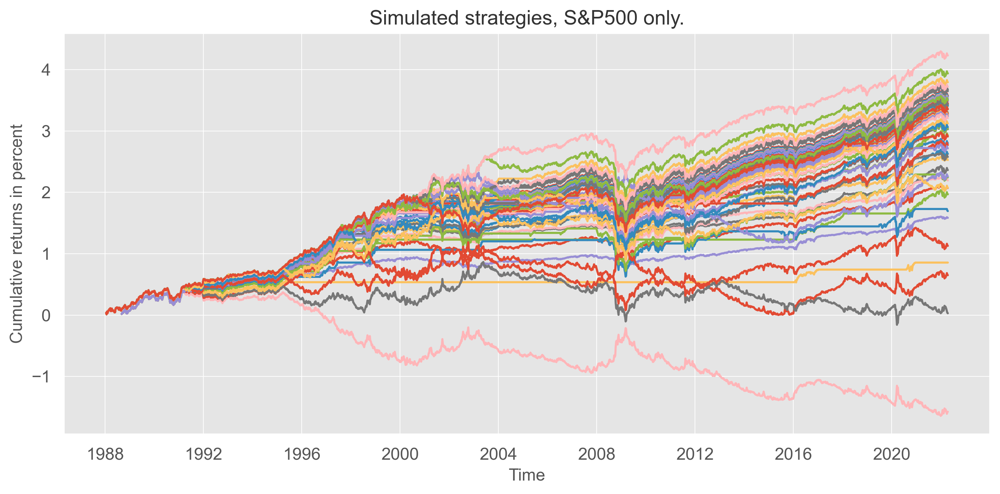

In [13]:
fig = plt.figure(figsize=(10, 5))
# Strategy
for strat in performance.columns:
    plt.plot(performance[strat].cumsum(), label = i)
plt.ylabel('Cumulative returns in percent')
plt.xlabel('Time')
# Plotting
plt.title('Simulated strategies, S&P500 only.')
plt.tight_layout()
plt.show()

**Ranked strategy performance.** Backtests are performed to examine whether the investor sentiment has market timing capabilities. Backtests with less than 15 signals are excluded.

In [14]:
# Show the top 20 sharpe ratio strategies with more than 15 signals since inception
strategies[strategies['# of signals'] >= 15].head(20)

,id,short_weight,long_switch,short_switch,strat_sharpe,bench_sharpe,# of signals
37,38.0,0.0,0.30,0.50,0.719178,0.605594,15.0
21,22.0,0.3,0.30,0.50,0.710815,0.605594,15.0
5,6.0,0.5,0.30,0.50,0.689320,0.605594,15.0
45,46.0,0.0,0.40,0.50,0.662877,0.605594,23.0
29,30.0,0.3,0.40,0.50,0.654329,0.605594,23.0
13,14.0,0.5,0.40,0.50,0.644062,0.605594,23.0
61,62.0,-1.0,0.40,0.50,0.631713,0.605594,23.0
25,26.0,0.3,0.35,0.50,0.629665,0.605594,19.0
9,10.0,0.5,0.35,0.50,0.627138,0.605594,19.0
41,42.0,0.0,0.35,0.50,0.625713,0.605594,19.0


In [15]:
# Show the plots of the top strategies.
# for index, strat in strategies[strategies['# of signals'] >= 15].iterrows():
#     backtest(df, strat['long_switch'], strat['short_switch'], strat['short_weight'], plots = True)

As the table shows, there seems to be no market timing potential in the data. The sharpe ratio is only marginally larger, when shorting is allowed. The sharpe ratio is larger, when the strategy is not invested. 

**Top strategy metric comparison**

Strategy: 0.3 (long switch), 0.5 (short switch), -1 (short weight)

Benchmark: 0.4 (long switch), 0.5 (short switch), -1 (short weight)

In [16]:
# Create performance reports for 2 of the top strategies to compare them.
qs.reports.metrics(backtest(df['1988-01-01':], 0.3, 0.5, -1, plots = False)['Strategy'].dropna(),
                   backtest(df['1988-01-01':], 0.4, 0.5, -1, plots = False)['Strategy'].dropna(), 
                   periods_per_year = 52
                  )

                    Strategy    Benchmark
------------------  ----------  -----------
Start Period        1988-01-15  1988-01-15
End Period          2022-04-14  2022-04-14
Risk-Free Rate      0.0%        0.0%
Time in Market      100.0%      100.0%

Cumulative Return   1,344.20%   2,010.99%
CAGR﹪              8.1%        9.31%

Sharpe              0.56        0.63
Sortino             0.82        0.9
Sortino/√2          0.58        0.64
Omega               1.24        1.24

Max Drawdown        -58.53%     -54.38%
Longest DD Days     3857        2282

Gain/Pain Ratio     0.24        0.28
Gain/Pain (1M)      0.59        0.68

Payoff Ratio        0.98        0.98
Profit Factor       1.24        1.28
Common Sense Ratio  1.38        1.32
CPC Index           0.67        0.72
Tail Ratio          1.11        1.03
Outlier Win Ratio   3.51        3.62
Outlier Loss Ratio  3.77        3.63

MTD                 -3.39%      -3.39%
3M                  -5.4%       -5.4%
6M                  1.9%        1

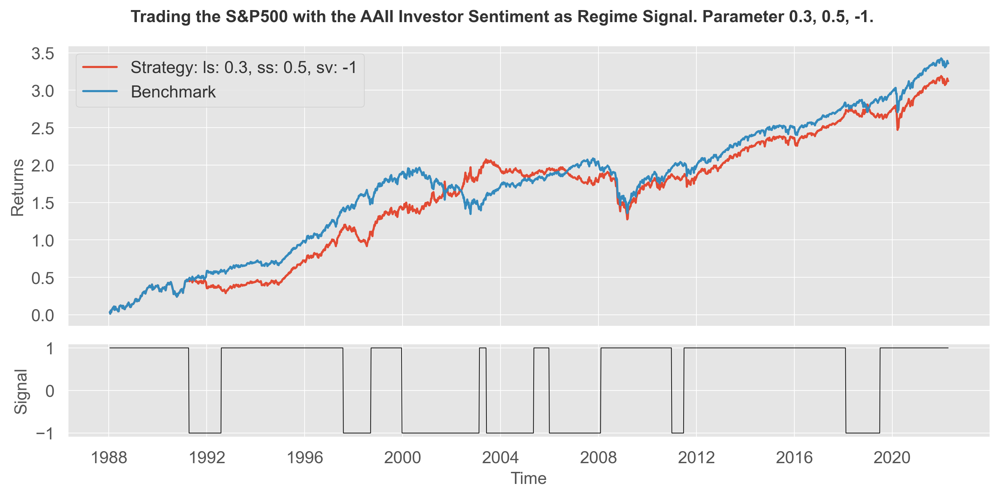

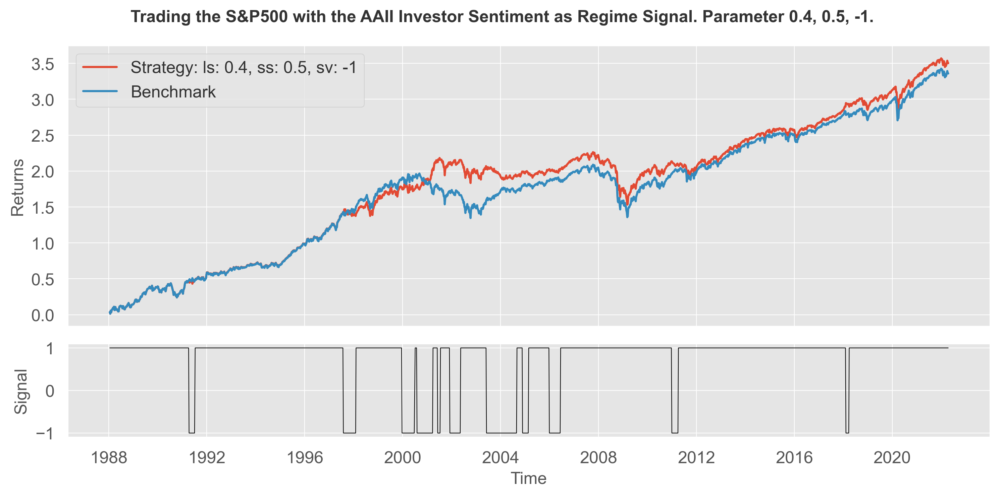

In [17]:
# Plot the 2 strategies
_ = backtest(df['1988-01-01':], 0.3, 0.5, -1, plots = True)
_ = backtest(df['1988-01-01':], 0.4, 0.5, -1, plots = True)

**Interpretation**: We cannot meaningfully time the market with investor sentiment

**Comparison with no investment**

Strategy: 0.3 (long switch), 0.5 (short switch), 0 (short weight)

Benchmark: S&P500 buy and hold

In [18]:
# Create performance reports for 2 of the top strategies to compare them.
qs.reports.metrics(backtest(df['1988-01-01':], 0.3, 0.5, 0, plots = False)['Strategy'].dropna(),
                   df.loc['1988-01-01':, 'Close'].pct_change().dropna(), 
                   periods_per_year = 52
                  )

                    Strategy    Benchmark
------------------  ----------  -----------
Start Period        1988-01-15  1988-01-15
End Period          2022-04-14  2022-04-14
Risk-Free Rate      0.0%        0.0%
Time in Market      67.0%       100.0%

Cumulative Return   1,792.22%   1,726.87%
CAGR﹪              8.96%       8.85%

Sharpe              0.72        0.61
Sortino             1.03        0.85
Sortino/√2          0.73        0.6
Omega               1.42        1.42

Max Drawdown        -49.39%     -54.38%
Longest DD Days     1582        2618

Gain/Pain Ratio     0.42        0.27
Gain/Pain (1M)      1.12        0.65

Payoff Ratio        0.95        0.95
Profit Factor       1.42        1.27
Common Sense Ratio  1.63        1.27
CPC Index           0.81        0.7
Tail Ratio          1.15        1.01
Outlier Win Ratio   6.39        3.46
Outlier Loss Ratio  3.61        3.48

MTD                 -3.39%      -3.39%
3M                  -5.4%       -5.4%
6M                  1.9%        1.

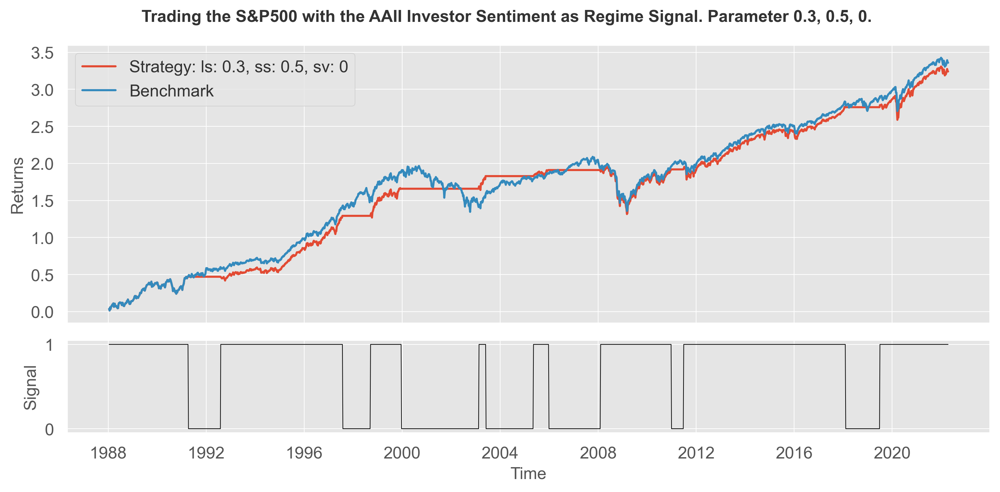

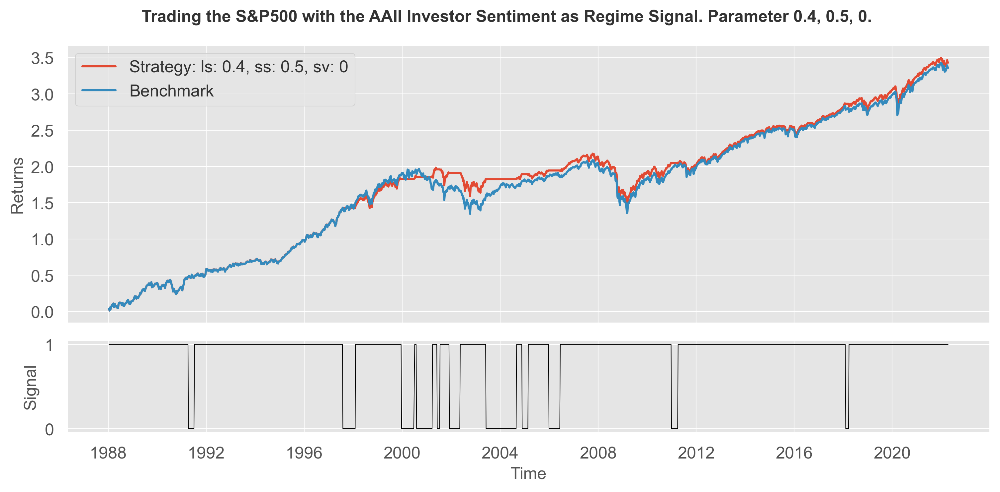

In [19]:
# Plot the 2 strategies
_ = backtest(df['1988-01-01':], 0.3, 0.5, 0, plots = True)
_ = backtest(df['1988-01-01':], 0.4, 0.5, 0, plots = True)

There is a meaningful increase in the sharpe ratio, however, this is mostly due to the strategy being out of the market, which makes this ratio misleading. In returns, it is actually underperforming.

## Conclusion
As the backtests showed, there is no value in looking at the moving average of the spread in investor sentiment as a timing indicator.

---

## Part 3: Test with Bonds

If investor sentiment is not particularly useful to look at timing, maybe it is useful to reduce risk in equities and switch to another asset class, e.g. bonds. The reason is, that the indicator seems to be able to actually find sideways performances in equities.

**Showing data for Treasury Bond futures.** The data consists of the 10 year US Treasury Bond Future, with daily frequency (later curated to weekly to match the AAII data). The data is already adjusted for the future roll. The future is used because it is the actually tradable instrument. *(The data is not published in the repository, as it is taken from Bloomberg. If you want to run the script yourself, download the data and import it here)*

In [20]:
# Importing treasury data
df2 = pd.read_excel('bloomberg_treasury_price_data.xlsx', index_col = 'Dates', parse_dates = True)

In [21]:
# Showing treasury data
df2

,TY1 Comdty
Dates,
1987-01-02,104.093750
1987-01-05,104.562500
1987-01-06,104.468750
1987-01-07,104.625000
1987-01-08,104.593750
...,...
2022-04-21,118.750000
2022-04-22,118.937500
2022-04-25,119.609375


In [22]:
# Joining treasury data to AAII data
df = df.join(df2, how='left')

In [23]:
# Running a backtest with selective inputs
def backtest2(df, long_switch, short_switch, short_value=0, var = 'Mov Avg', plots = True):
    """
        Runs a backtest of a trading strategy based on AAII data.
        NOT A REPRESENTATION OF HOW THE STRATEGY WILL PERFORM! 
        Does not include any trading costs. 
        Includes overfitting to a certain degree.
        
        df (DataFrame): Data from AAII
        long_switch (float): Level to switch to long regime
        short_switch (float): Level to switch to short regime
        short_value (float): Investment size when a short regime exists.
        plots (boolean): Backtest performance plot yes or no.
        
        Returns dataframe with index dates 
        and columns for S&P500 returns, signals and strategy returns.
    """
    
    # Setting rule conditions
    conditions = [
        (df[var] < long_switch),
        (df[var] > short_switch)
    ]
    # Setting rule choices
    choices = [1, short_value]
    # Calculating signal
    signals = pd.DataFrame(np.select(conditions, choices, default = np.nan), index = df.index, columns = ['Signal']).ffill()
    df = df.join(signals, how='left')
    
    # Calculating strategy returns
    portfolio = pd.concat([df[['Close', 'TY1 Comdty']].pct_change(), signals.shift(1)], axis = 1).iloc[1:]
    
    portfolio['Strategy'] = np.nan
    for index, row in portfolio.iterrows():
        if row['Signal'] == 1:
            portfolio.loc[index, 'Strategy'] = row['Signal'] * row['Close']
        else:
            portfolio.loc[index, 'Strategy'] = row['Signal'] * row['TY1 Comdty'] 
    
    # Plot
    if plots == True:
        fig, ax = plt.subplots(2, 
                               figsize=(10, 5), 
                               sharex=True, 
                               gridspec_kw={'height_ratios': [3, 1]}
                              )
        # Strategy
        ax[0].plot(portfolio['Strategy'].cumsum(), label = f'Strategy: ls: {long_switch}, ss: {short_switch}, sv: {short_value}')
        ax[0].plot(portfolio['Close'].cumsum(), label = 'Benchmark')
        ax[0].legend()
        ax[0].set_ylabel('Returns')
        # Signals
        ax[1].plot(portfolio['Signal'], color = 'black', linewidth = 0.5, label = 'Signal')
        ax[1].set_ylabel('Signal')
        ax[1].set_xlabel('Time')
        # Plotting
        plt.suptitle(f'Trading the S&P500 with the AAII Investor Sentiment as Regime Signal. Parameter {long_switch}, {short_switch}, {short_value}.', fontweight="bold")
        plt.tight_layout()
        plt.show()
    
    # Returns strategy dataframe
    return portfolio

In [24]:
# Create dictionary for all strategies
strategies = {
    'id': [],
    'short_weight': [],
    'long_switch': [],
    'short_switch': [],
    'strat_sharpe': [],
    'bench_sharpe': [],
    '# of signals': []
}
performance = pd.DataFrame()
i = 0

# Running through many variables to optimize for sharpe ratio
# This creates overfitting! Do not use for investment, only for indicator analysis.
for short_weight in [-0.5, 0.0, 0.3, 0.5, 0.75, 0.999]:
    for long_switch in [0.25, 0.3, 0.35, 0.4]:
        for short_switch in [0.45, 0.5, 0.55, 0.6]:
            
            i += 1
            
            # Get backtest data
            portfolio = backtest2(df['1988-01-01':], long_switch, short_switch, short_weight, plots = False)
            
            # Append to dict.
            strategies['id'].append(i)
            strategies['short_weight'].append(short_weight)
            strategies['long_switch'].append(long_switch)
            strategies['short_switch'].append(short_switch)
            strategies['strat_sharpe'].append(qs.stats.sharpe(portfolio.loc['1988-01-01':, 'Strategy'].dropna(), periods = 52))
            strategies['bench_sharpe'].append(qs.stats.sharpe(portfolio.loc['1988-01-01':, 'Close'].dropna(), periods = 52))
            strategies['# of signals'].append(portfolio[portfolio['Signal'].diff() != 0]['Signal'].count())
            performance[i] = portfolio['Strategy']

# Put data into dataframe and sort after sharpe ratio
strategies = pd.DataFrame().from_dict(strategies, orient = 'index').T.sort_values('strat_sharpe', ascending=False)

**Backtests:** Plotting all calculated strategies

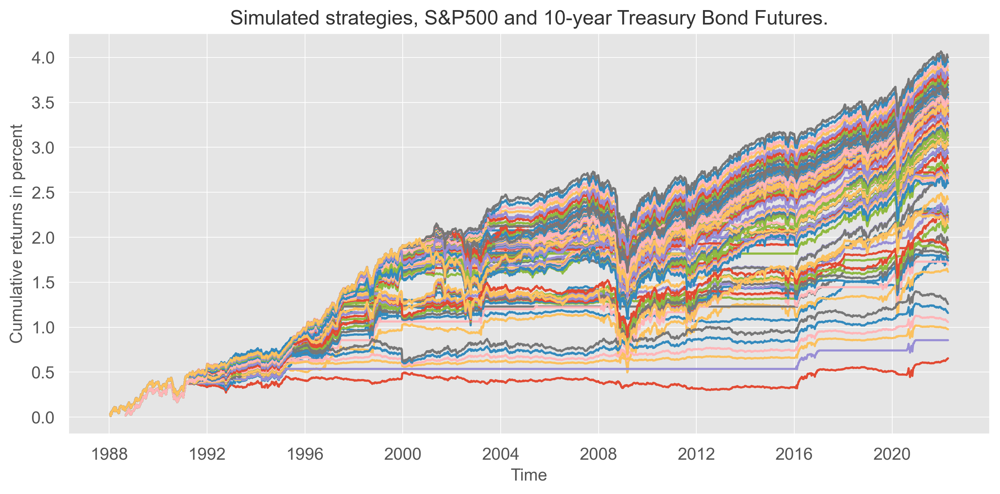

In [25]:
fig = plt.figure(figsize=(10, 5))
# Strategy
for strat in performance.columns:
    plt.plot(performance[strat].cumsum(), label = i)
plt.ylabel('Cumulative returns in percent')
plt.xlabel('Time')
# Plotting
plt.title('Simulated strategies, S&P500 and 10-year Treasury Bond Futures.')
plt.tight_layout()
plt.show()

**Again the backtests are run, this time with long treasuries when the regime switches**

In [26]:
# Show the top 20 sharpe ratio strategies with more than 15 signals since inception
strategies[strategies['# of signals'] >= 15].head(20)

,id,short_weight,long_switch,short_switch,strat_sharpe,bench_sharpe,# of signals
85,86.0,0.999,0.30,0.50,0.765759,0.605594,15.0
69,70.0,0.750,0.30,0.50,0.759799,0.605594,15.0
53,54.0,0.500,0.30,0.50,0.750095,0.605594,15.0
37,38.0,0.300,0.30,0.50,0.739561,0.605594,15.0
21,22.0,0.000,0.30,0.50,0.719178,0.605594,15.0
5,6.0,-0.500,0.30,0.50,0.674016,0.605594,15.0
13,14.0,-0.500,0.40,0.50,0.671177,0.605594,23.0
29,30.0,0.000,0.40,0.50,0.662877,0.605594,23.0
45,46.0,0.300,0.40,0.50,0.654793,0.605594,23.0
61,62.0,0.500,0.40,0.50,0.648168,0.605594,23.0


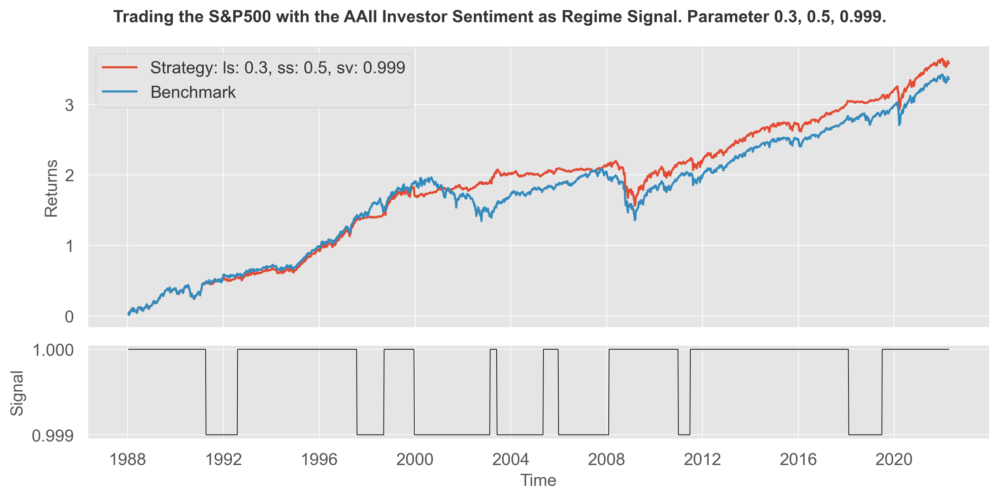

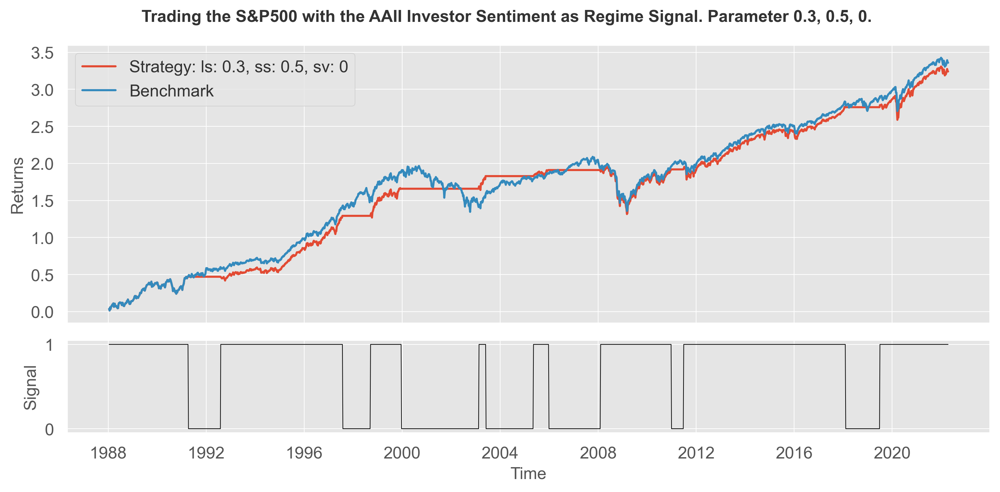

In [27]:
# Plot the 2 strategies
_ = backtest2(df['1988-01-01':], 0.3, 0.5, 0.999, plots = True)
_ = backtest2(df['1988-01-01':], 0.3, 0.5, 0, plots = True)

**Comparison of Equities - Treasuries Regime strategy with Equities buy and hold**

Strategy: 0.3 (long switch), 0.5 (short switch), 1 (Bond weight)

Benchmark: S&P500 buy and hold

In [28]:
# Create performance reports for 2 of the top strategies to compare them.
qs.reports.metrics(backtest2(df['1988-01-01':], 0.3, 0.5, 0.999, plots = False)['Strategy'].dropna(),
                   df.loc['1988-01-01':, 'Close'].pct_change().dropna(), 
                   periods_per_year = 52
                  )

                    Strategy    Benchmark
------------------  ----------  -----------
Start Period        1988-01-15  1988-01-15
End Period          2022-04-14  2022-04-14
Risk-Free Rate      0.0%        0.0%
Time in Market      100.0%      100.0%

Cumulative Return   2,501.26%   1,726.87%
CAGR﹪              9.98%       8.85%

Sharpe              0.77        0.61
Sortino             1.09        0.85
Sortino/√2          0.77        0.6
Omega               1.38        1.38

Max Drawdown        -49.39%     -54.38%
Longest DD Days     1400        2618

Gain/Pain Ratio     0.38        0.27
Gain/Pain (1M)      0.97        0.65

Payoff Ratio        0.94        0.96
Profit Factor       1.38        1.27
Common Sense Ratio  1.57        1.27
CPC Index           0.76        0.71
Tail Ratio          1.14        1.01
Outlier Win Ratio   4.34        3.46
Outlier Loss Ratio  4.61        3.49

MTD                 -3.39%      -3.39%
3M                  -5.4%       -5.4%
6M                  1.9%        1

**Results:** As observable, the strategy actually improves meaningfully. One can draw the conclusion that it is useful for investors to adjust risk aversion when sentiment is at the extremes.

---

## Part 4: Regression analysis

To detect if there is a linear relation between the regime switch in stocks and bonds and sentiment levels, a simple linear regression is performed. 

The data is separated in the quintiles ones for the actual spread and ones for the moving average of the spread and then the performance of bonds and stocks is evaluated. The goal is to see if correlations change with sentiment, therefore making a regime trade useful or useless.

For every quintile of the sentiment data, for the Spread and the moving average of the Spread
    (1) a regression is calculated,
    (2) the signal lines are plotted, 
    (3) a backtest is performed,
    (4) and a scatterplot is plotted.

In [29]:
# Plotting scatter plots with multiple slices between selected variables.
def regressions(df, var1 = 'TY1 Comdty', var2 = 'Close', rank = 'Mov Avg', rank_quintile = 0.0):
    """
        Plots a scatter plot between returns and a variable with ranks of another variable.
        df (DataFrame): Data from AAII
        var (String): Variable that plots against the returns
        rank (String): Variable that decides the quintile ranking
        rank_quintile (float): Sets the quintile which should be regressed
    """
    
    # Copy data for security
    df2 = df.copy()
    
    # Create quintiles
    df2[rank] = pd.qcut(df2[rank], 5, labels = False)
    
    # Slice data
    df2 = df2[[var1, var2, rank]]
    df2 = df2[df2[rank] == rank_quintile]
    
    # Setting up dependent and independent variable
    X = np.array(df2[var1].pct_change().dropna()).reshape(-1, 1)
    y = np.array(df2[var2].pct_change().dropna()).reshape(-1, 1)
    
    # Running regression
    reg = LinearRegression().fit(X, y)
    
    # Printing results
    _ = df[df.index.isin(df2.index)]['Mov Avg'].describe()
    print(rank_quintile, 
          f"| Min: {np.round(_['min'], 2)} | Max: {np.round(_['max'], 2)} | R^2: {np.round(reg.score(X, y), 4)} | Coef: {np.round(reg.coef_[0][0], 4)} | Interc.: {np.round(reg.intercept_[0], 4)}")
    
    # Data returns
    rets = {
        'Min': np.round(_['min'], 2), 
        'Max': np.round(_['max'], 2), 
        'R^2': np.round(reg.score(X, y), 4), 
        'Coef': reg.coef_[0][0], 
        'Interc.': reg.intercept_[0]
    }
    return rets

In [30]:
# Plotting scatter plots with multiple slices between selected variables.
def scatter_plots(df, 
                  var1 = 'Close', 
                  var2 = 'Mov Avg', 
                  rank = 'Bullish', 
                  rank_selection = False, 
                  rank_quintile = 0.0):
    """
        Plots a scatter plot between returns and a variable with ranks of another variable.
        df (DataFrame): Data from AAII
        var (String): Variable that plots against the returns
        rank (String): Variable that decides the quintile ranking
        rank_selection (Boolean): If True, show scatter
        rank_quintile (float): Sets the quintile which should be regressed
    """
    
    # Copy data for security
    df2 = df.copy()
    
    # Create quintiles
    df2[rank] = pd.qcut(df2[rank], 5, labels = False)
    
    # Slice data
    df2 = df2[[var1, var2, rank]]
    df2[var1] = df2[var1].pct_change()
    df2[var2] = df2[var2].pct_change()
    
    # rank selection condition. Show only rank 1
    if rank_selection == True:
        df2 = df2[df2[rank] == rank_quintile]
        #print(df[df.index.isin(df2.index)]['Mov Avg'].describe())
    
    # Plot scatterplot
    _ = sns.jointplot(
        y=df2[var1].shift(-1), 
        x = df2[var2].shift(-1), 
        hue=df2[rank], 
        height=8.27
    )
    # Set labels
    _.set_axis_labels(var2, var1, fontsize=12)
    # Set title
    _ = plt.suptitle(f'Scatter between {var1} and {var2} under {rank} partition.', fontweight="bold")
    _.figure.tight_layout()
    _ = plt.show()

In [31]:
# Visual plot for S&P500 versus selected variable
def sentiment_analysis2(df, var, h1 = 0.175, h2 = 0.31125):
    """
        Plots a figure with the S&P500 on top and a selected variable on the bottom.
        df: DataFrame - Data from AAII
        var: String - Name of selected variable
    """
    # Plot setup
    fig, ax = plt.subplots(3, figsize=(12, 7), sharex = True, gridspec_kw={'height_ratios': [3, 2, 2]})
    # Price index
    ax[0].plot(df['Close'])
    ax[0].set_title('S&P500 Index', fontsize = 12)
    ax[0].set_ylabel('Level')
    # variable
    ax[1].plot(df[var], color = 'b', linewidth = 0.5)
    ax[1].axhline(h1, color='black',ls='--')
    ax[1].axhline(h2, color='black',ls='--')
    ax[1].set_title(f'{var} AAII Investor Sentiment', fontsize = 12)
    ax[1].set_ylabel('Percentage')
    # variable change
    ax[2].plot(df[var].pct_change(), color = 'black', linewidth = 0.5, alpha = 0.7)
    ax[2].set_title(f'Change in {var} AAII Investor Sentiment', fontsize = 12)
    ax[2].set_ylabel('Points')
    ax[2].set_xlabel('Time')
    # Plot title
    plt.suptitle(f'Comparing the S&P500 with the {var} AAII Investor Sentiment.', fontsize = 17, fontweight="bold")
    plt.show()

0 | Min: 0.17 | Max: 0.31 | R^2: 0.0005 | Coef: -0.0931 | Interc.: 0.01


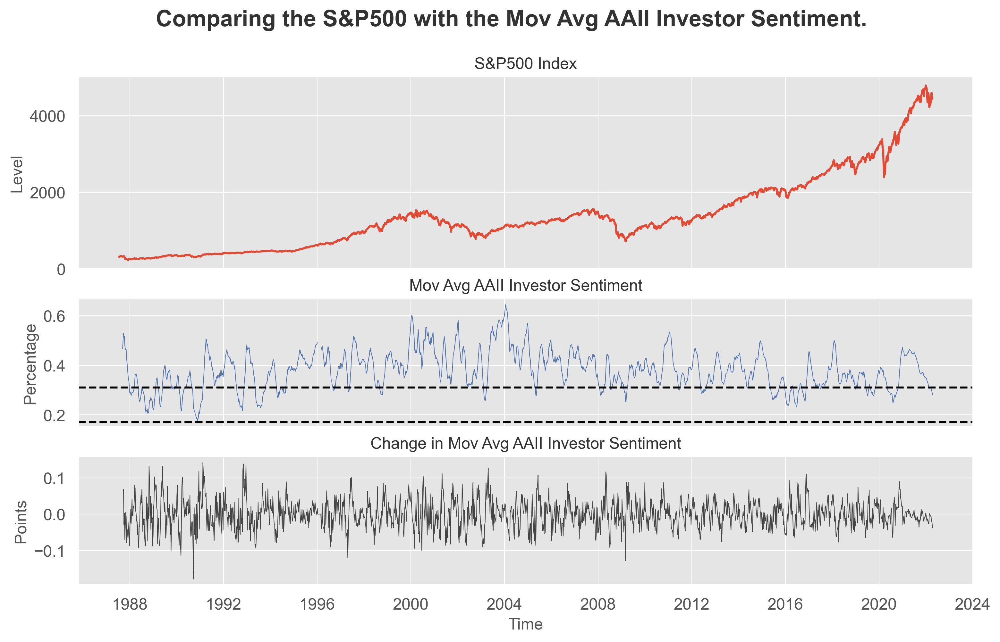

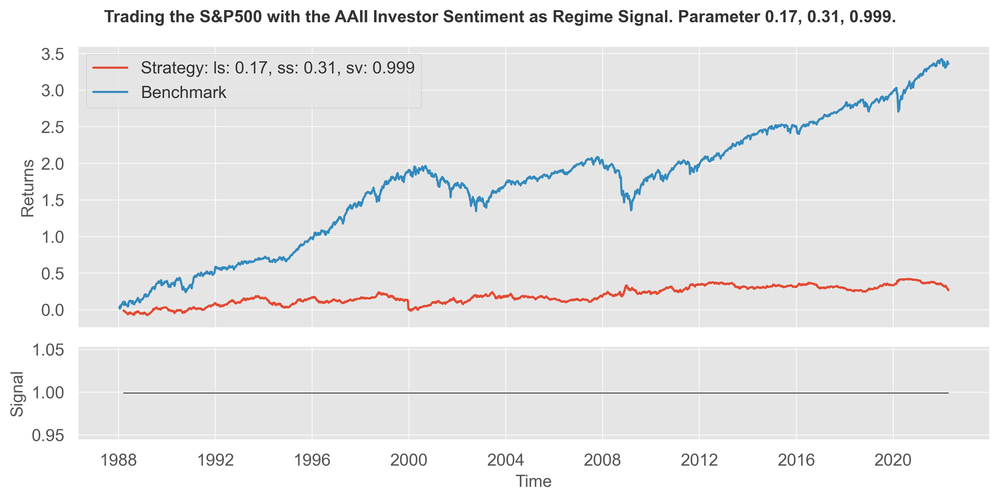

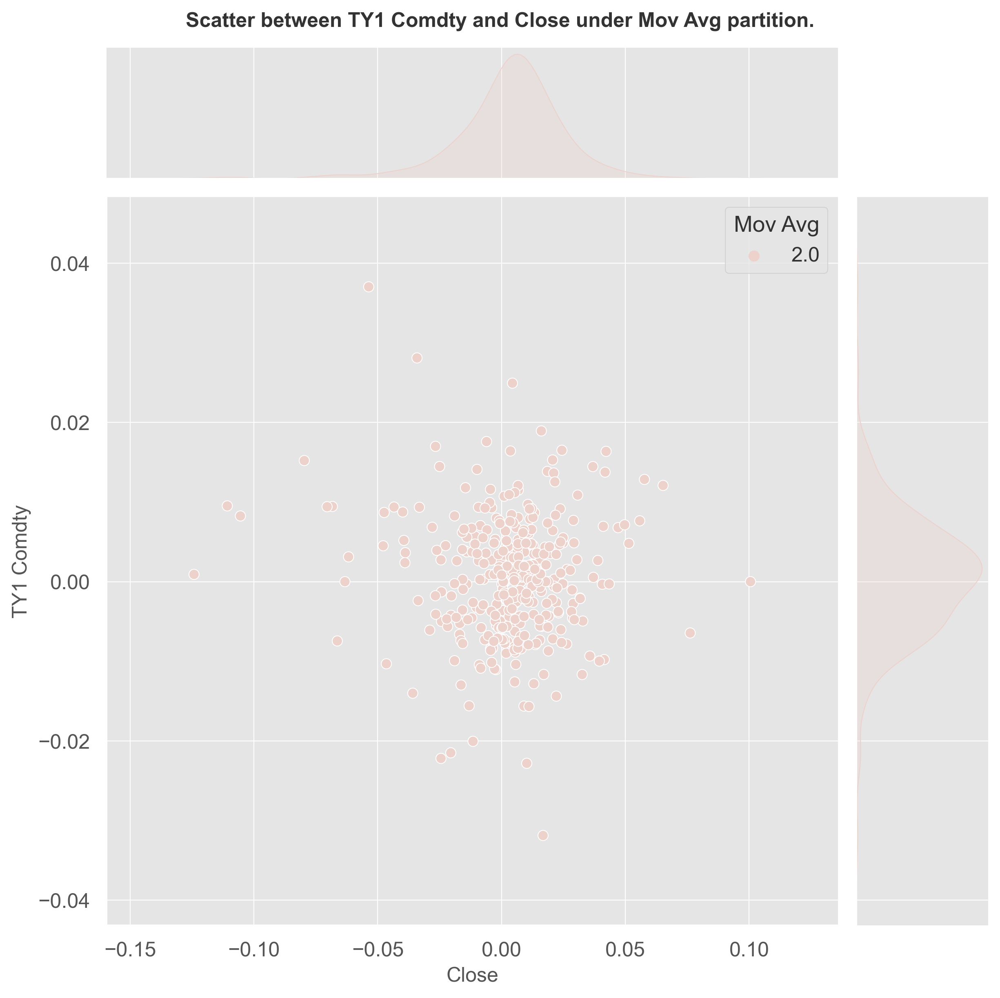

------------------------------------------------------------------------------------------------------------------------
1 | Min: 0.31 | Max: 0.36 | R^2: 0.0013 | Coef: -0.1184 | Interc.: 0.01


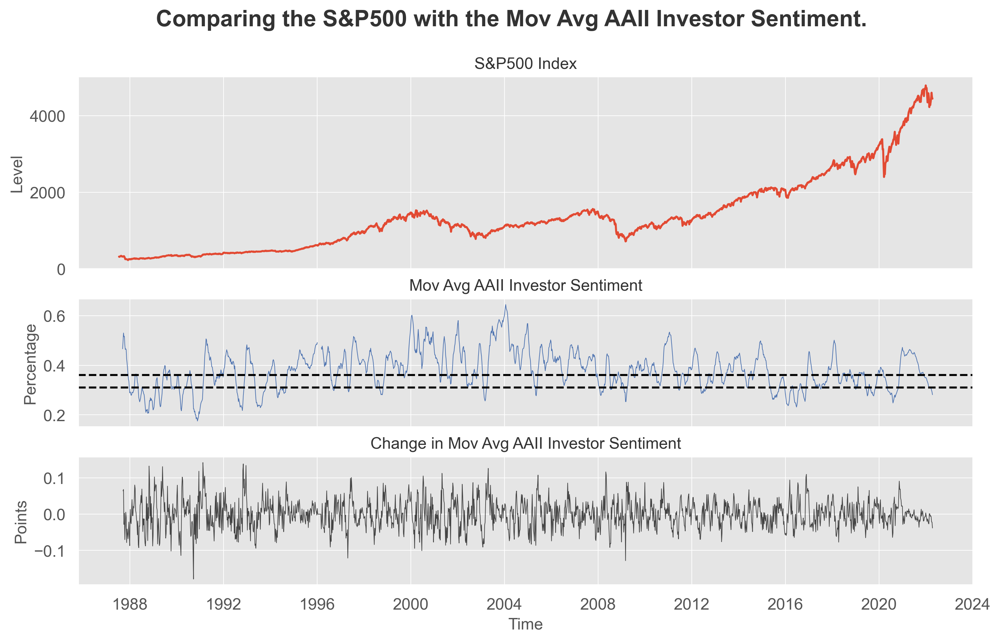

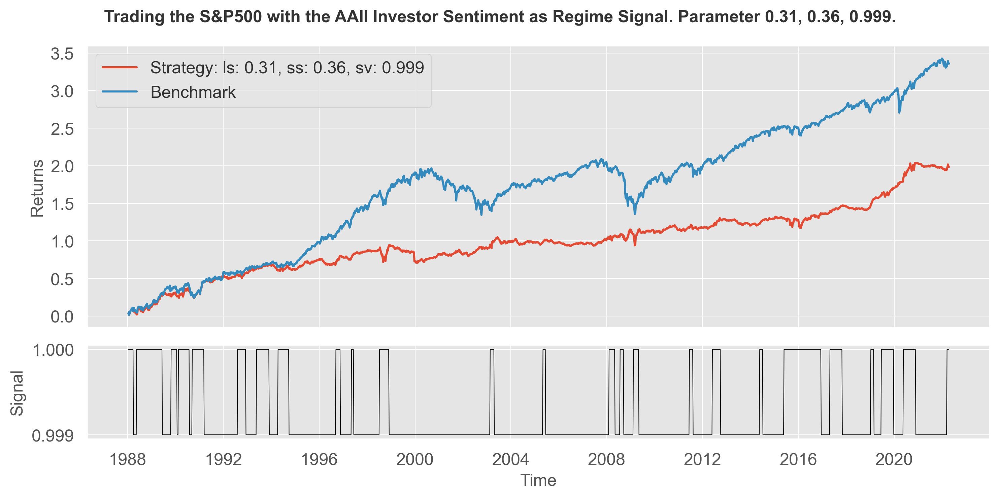

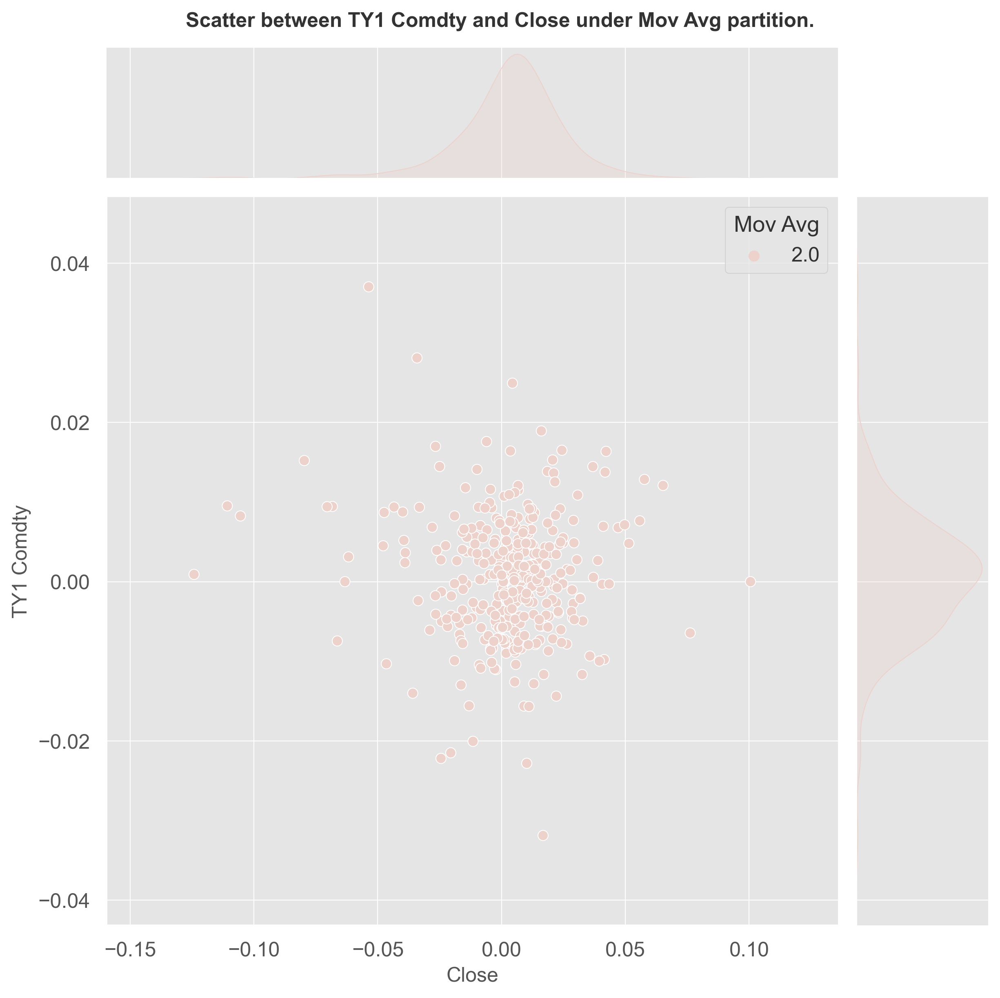

------------------------------------------------------------------------------------------------------------------------
2 | Min: 0.36 | Max: 0.4 | R^2: 0.0136 | Coef: -0.3497 | Interc.: 0.0099


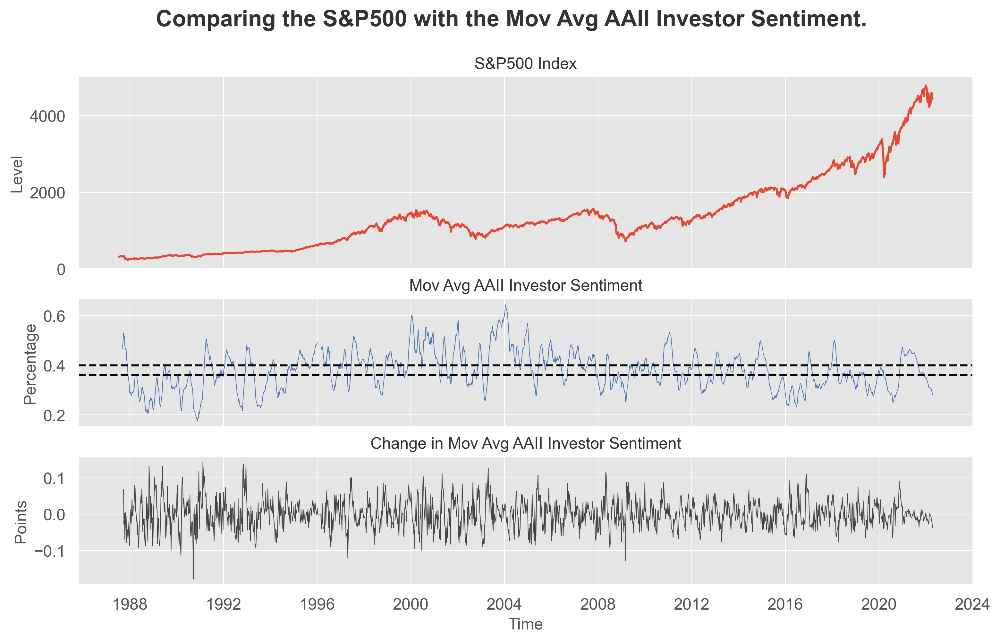

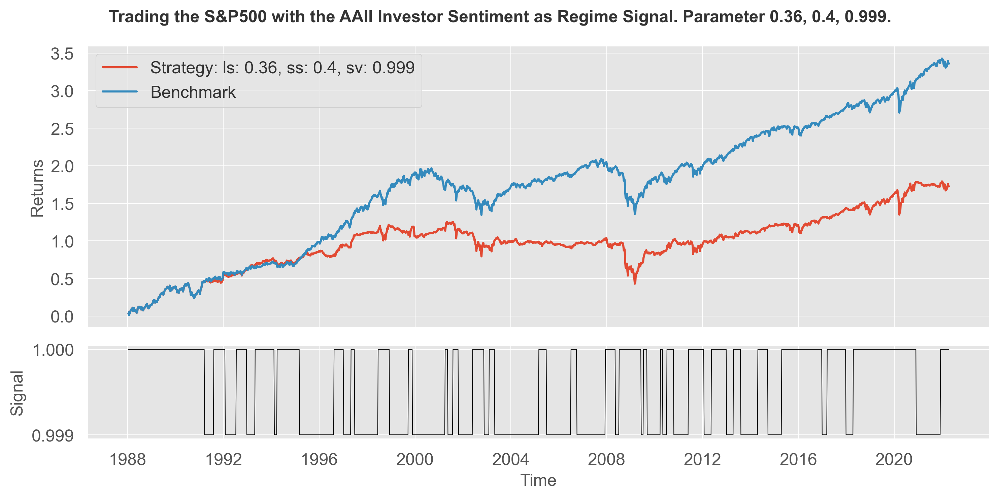

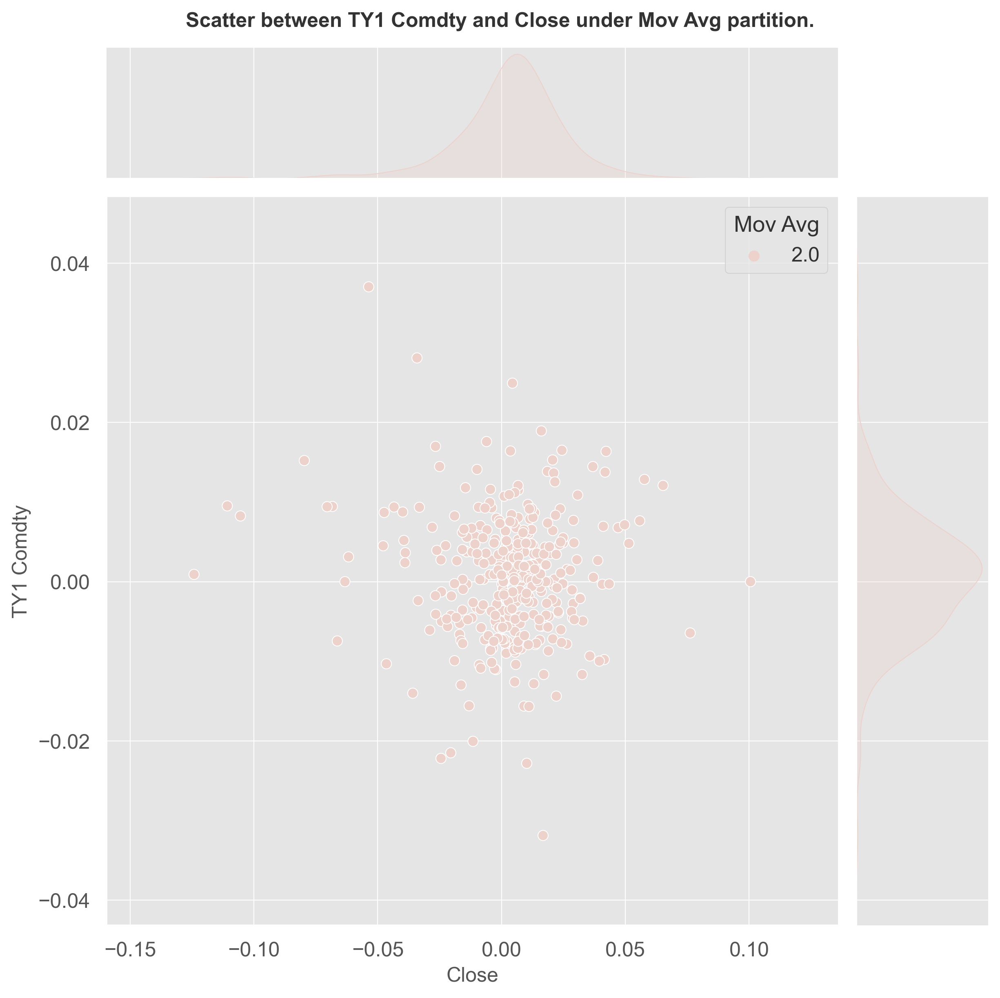

------------------------------------------------------------------------------------------------------------------------
3 | Min: 0.4 | Max: 0.44 | R^2: 0.0004 | Coef: -0.0525 | Interc.: 0.0093


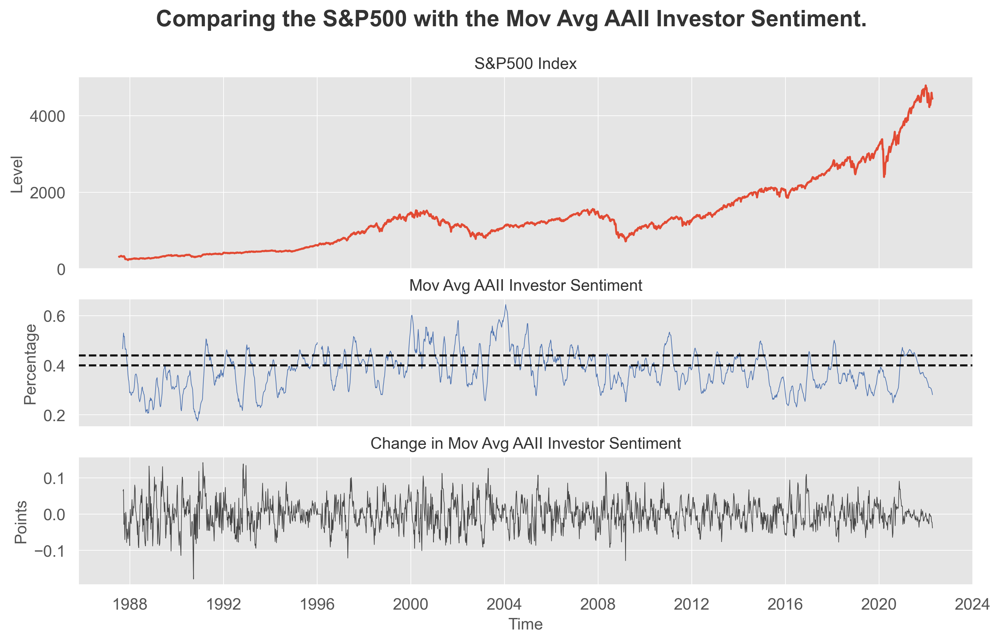

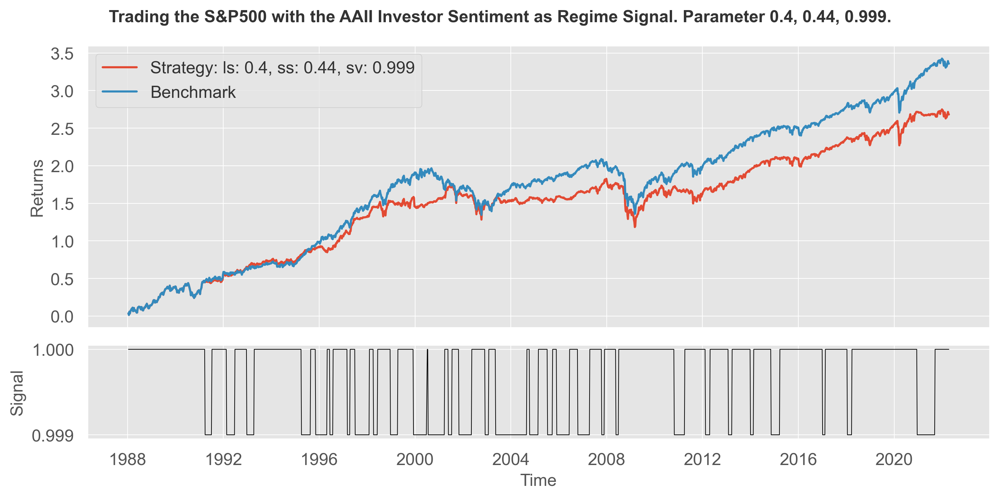

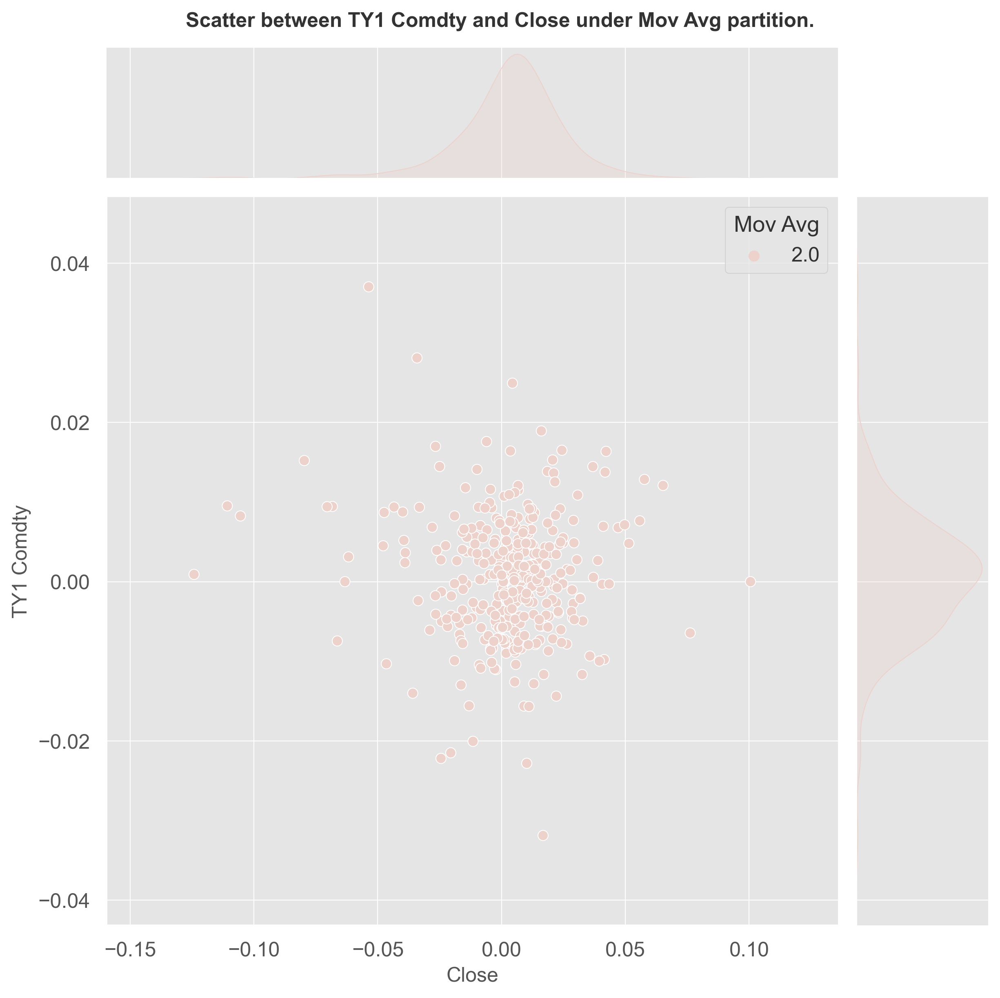

------------------------------------------------------------------------------------------------------------------------
4 | Min: 0.44 | Max: 0.64 | R^2: 0.0053 | Coef: 0.1948 | Interc.: 0.0081


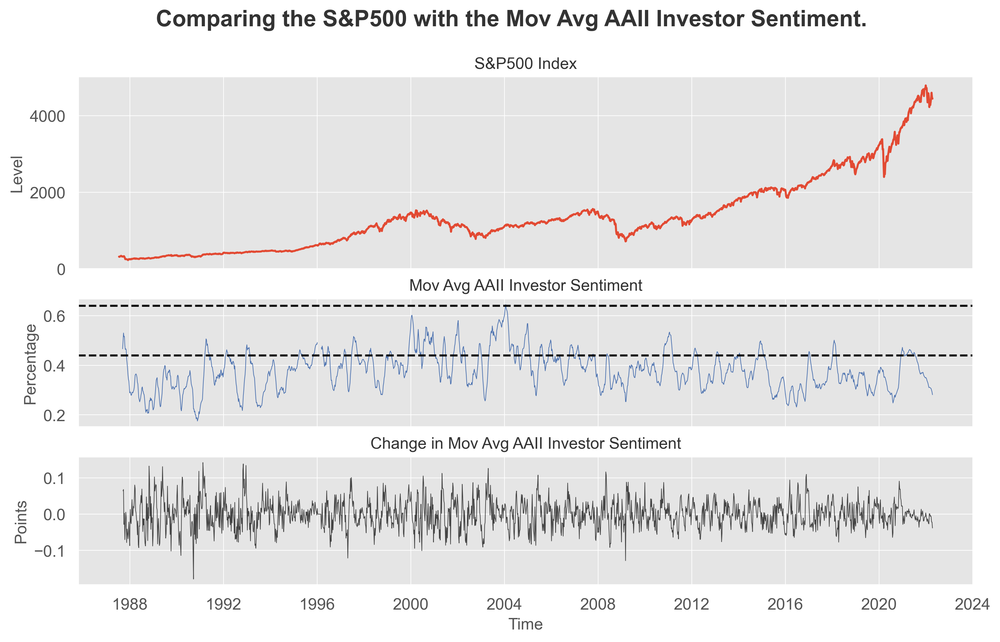

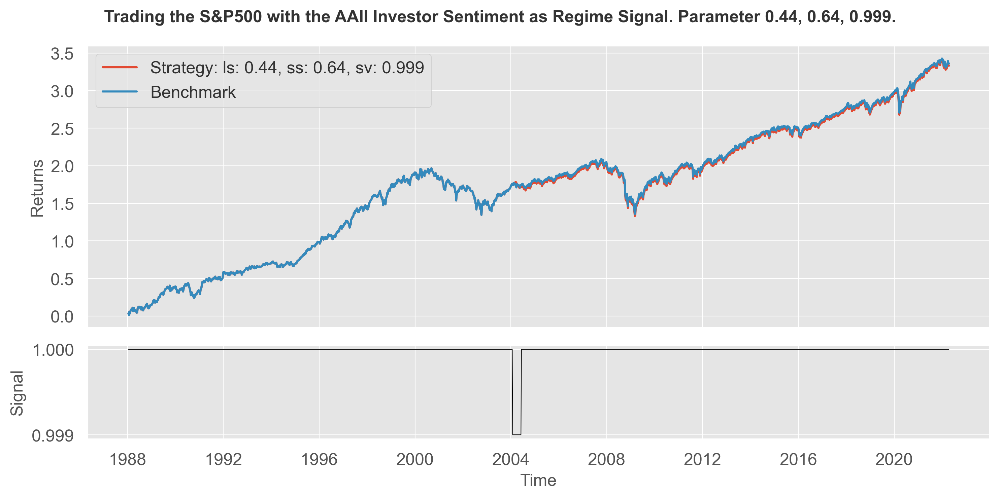

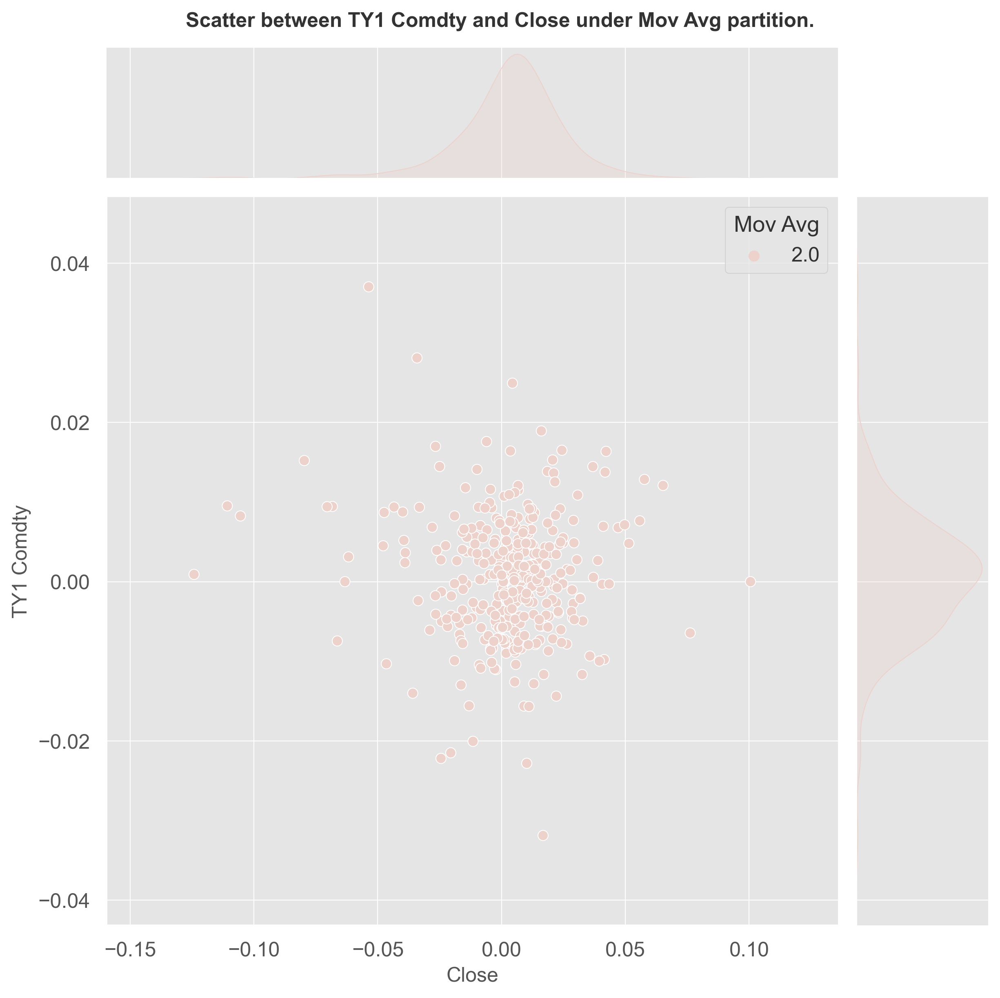

------------------------------------------------------------------------------------------------------------------------
0 | Min: 0.17 | Max: 0.49 | R^2: 0.0354 | Coef: -0.6416 | Interc.: 0.0108


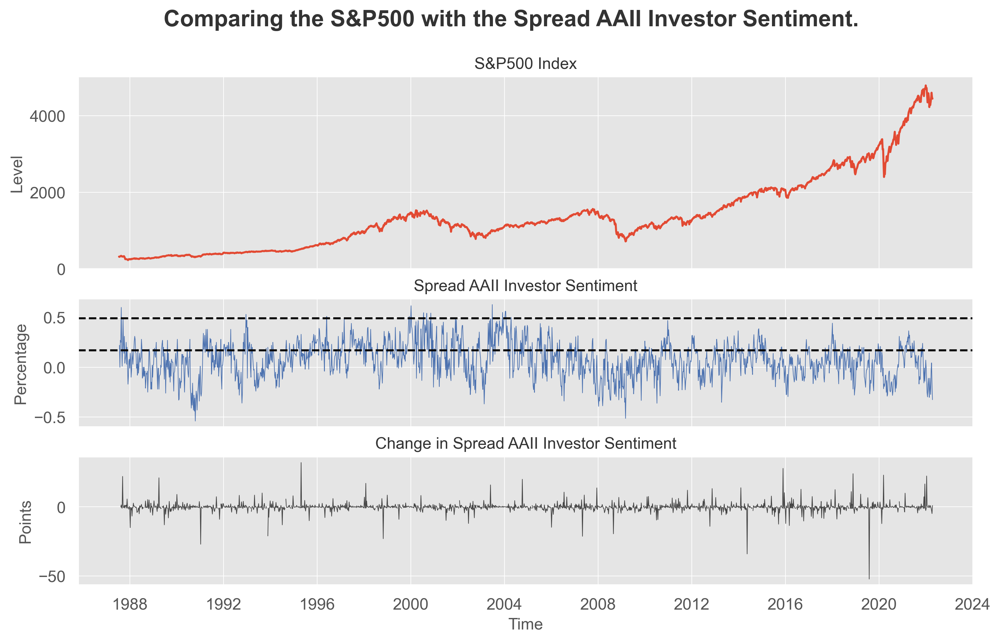

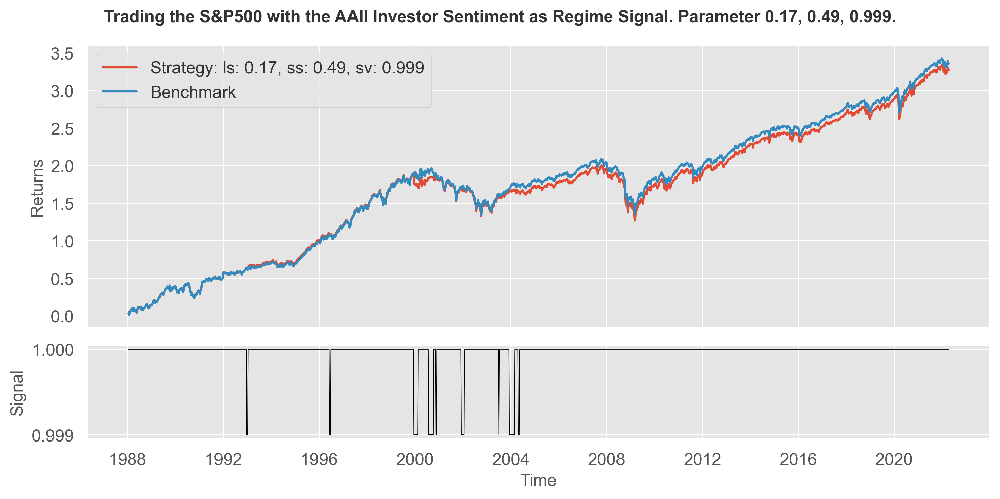

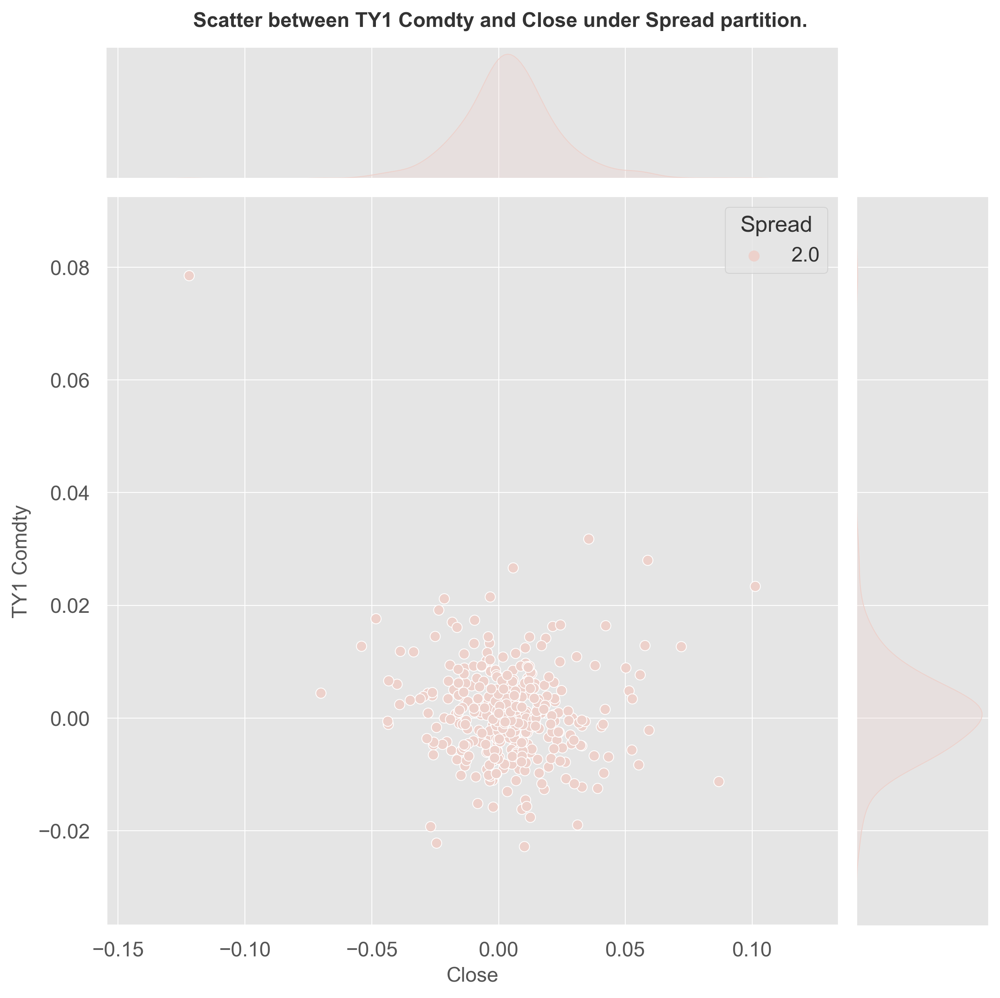

------------------------------------------------------------------------------------------------------------------------
1 | Min: 0.21 | Max: 0.54 | R^2: 0.018 | Coef: -0.3201 | Interc.: 0.0087


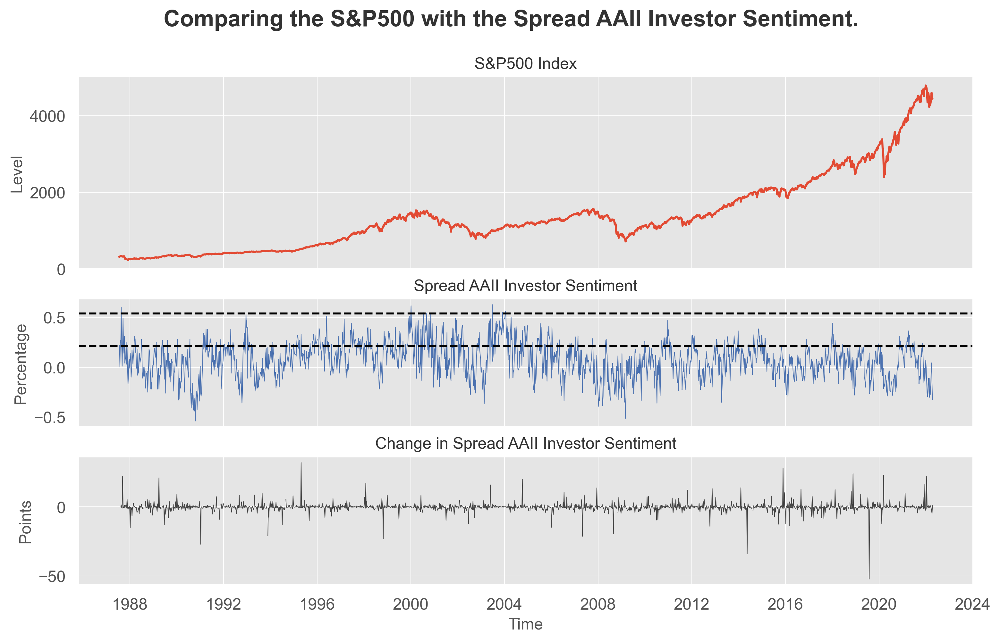

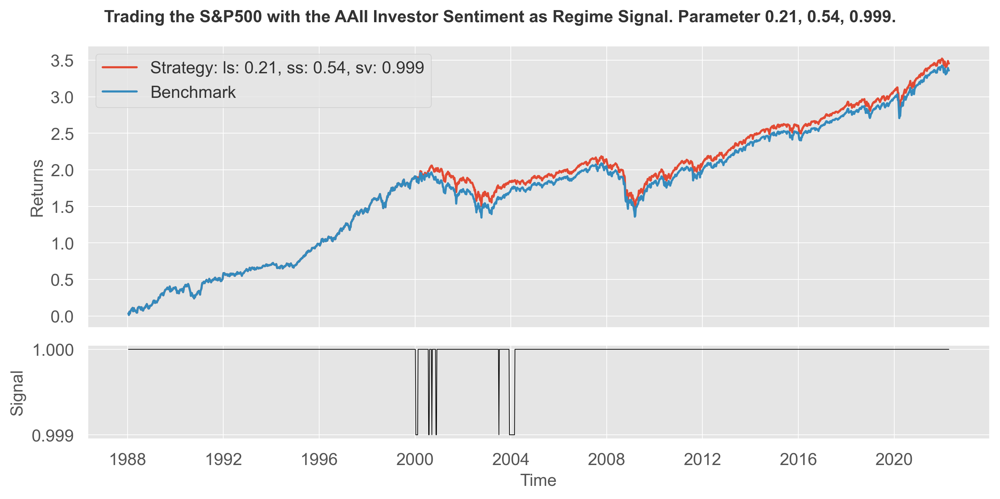

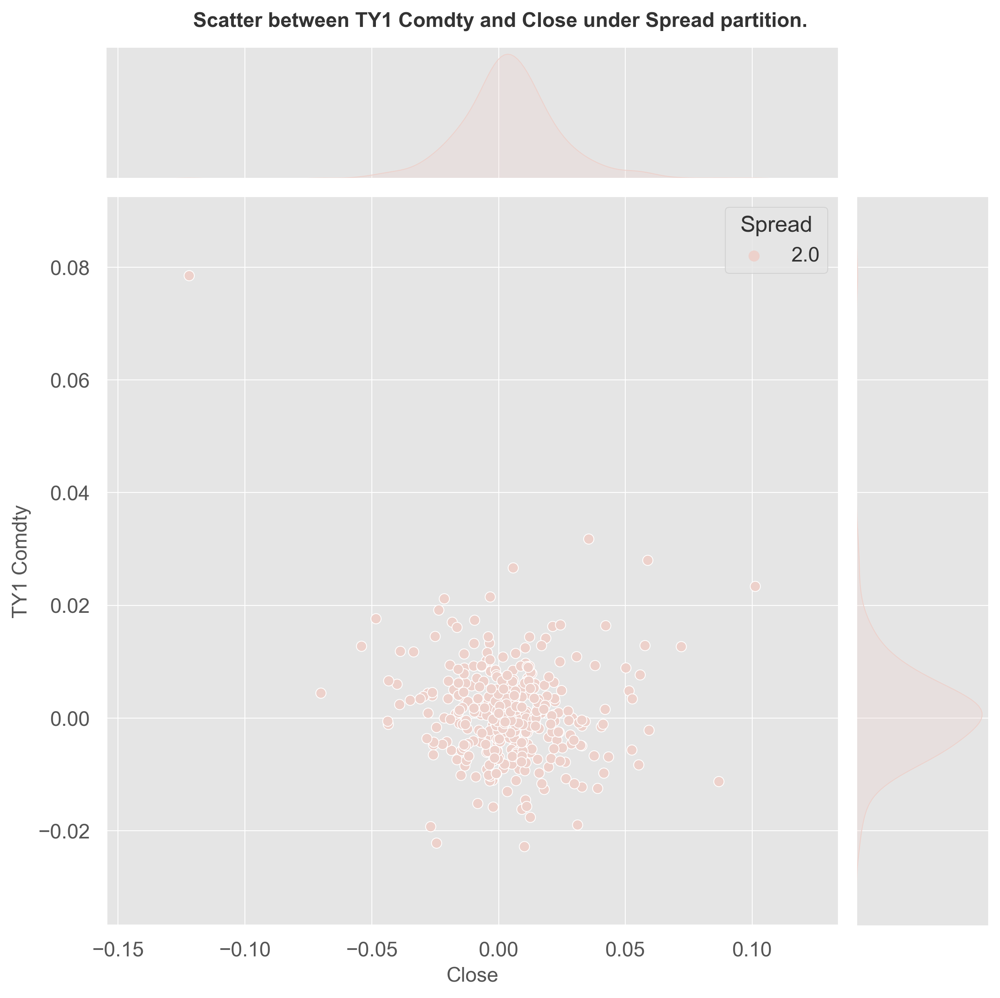

------------------------------------------------------------------------------------------------------------------------
2 | Min: 0.24 | Max: 0.58 | R^2: 0.0184 | Coef: -0.2782 | Interc.: 0.0088


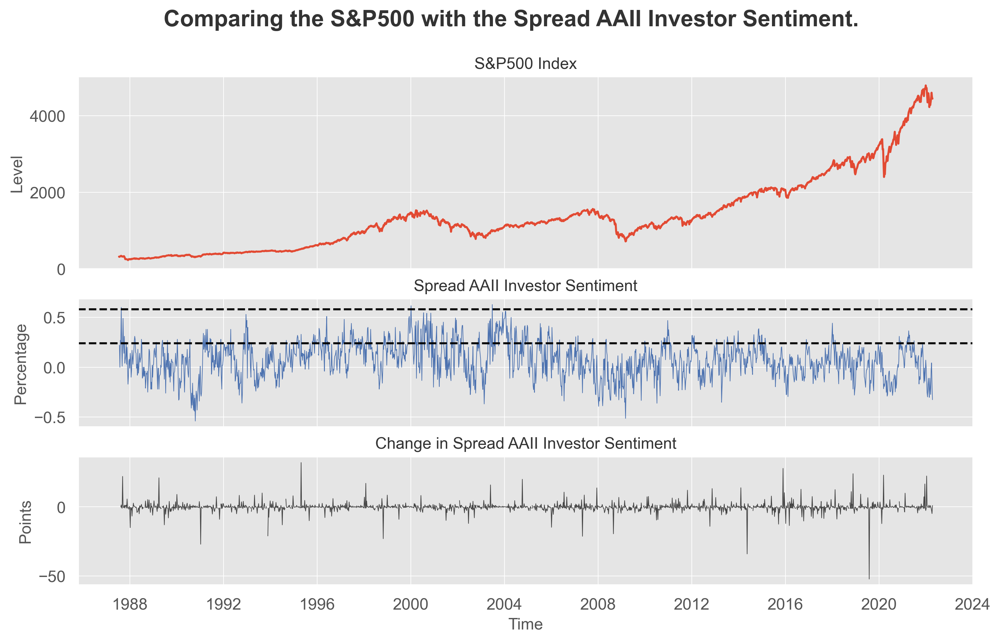

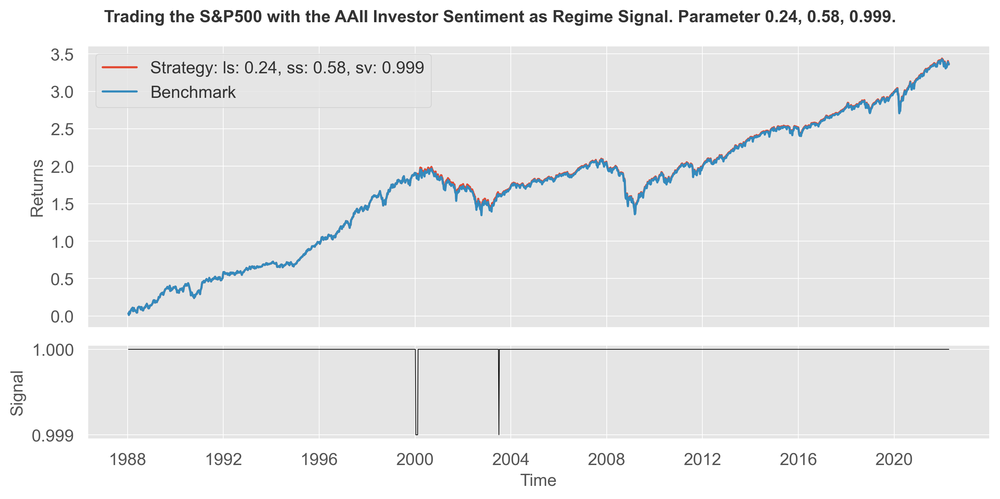

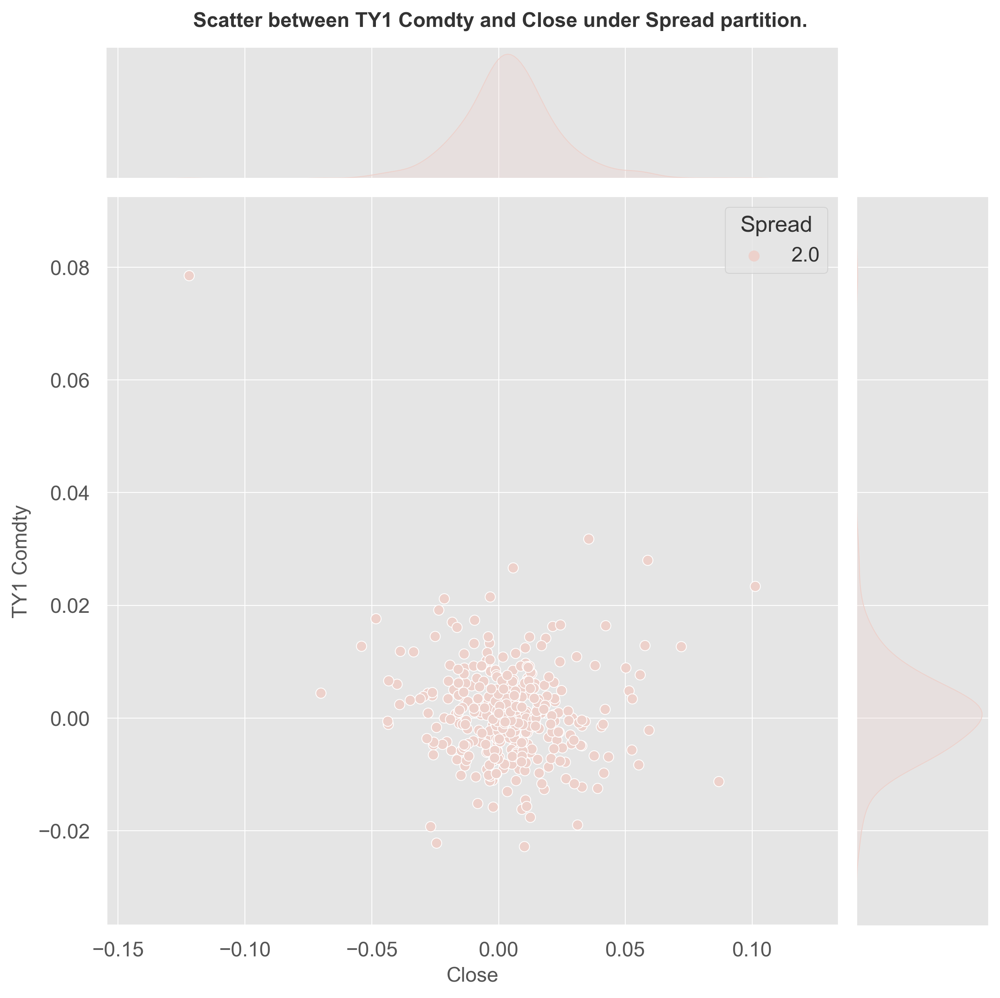

------------------------------------------------------------------------------------------------------------------------
3 | Min: 0.23 | Max: 0.58 | R^2: 0.0498 | Coef: -0.4324 | Interc.: 0.0089


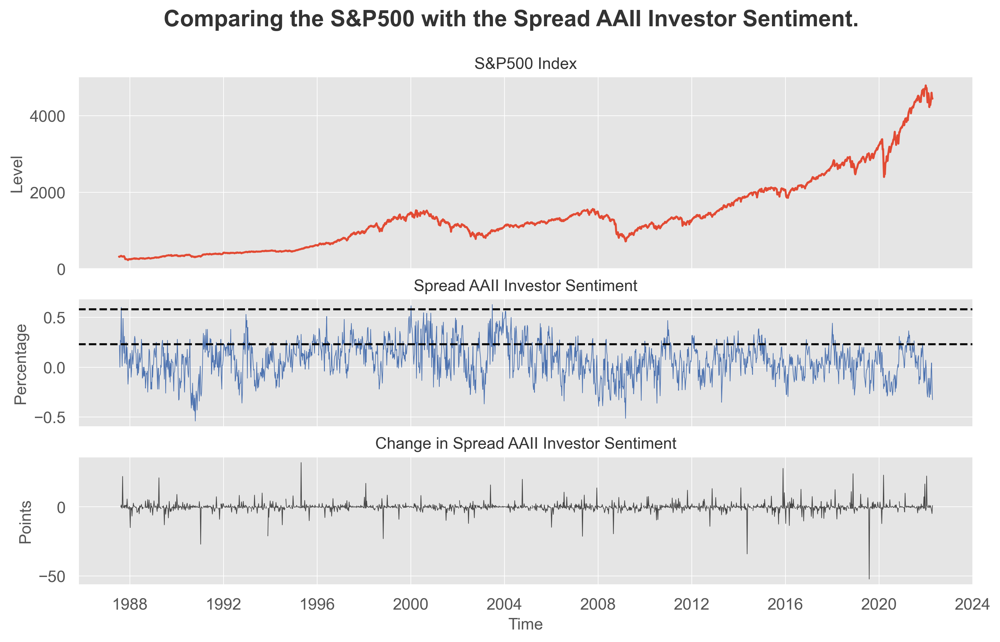

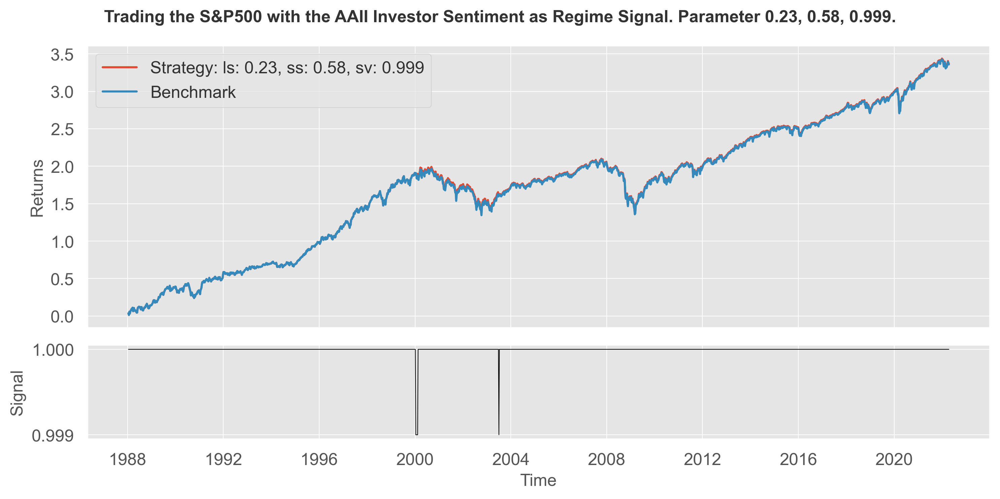

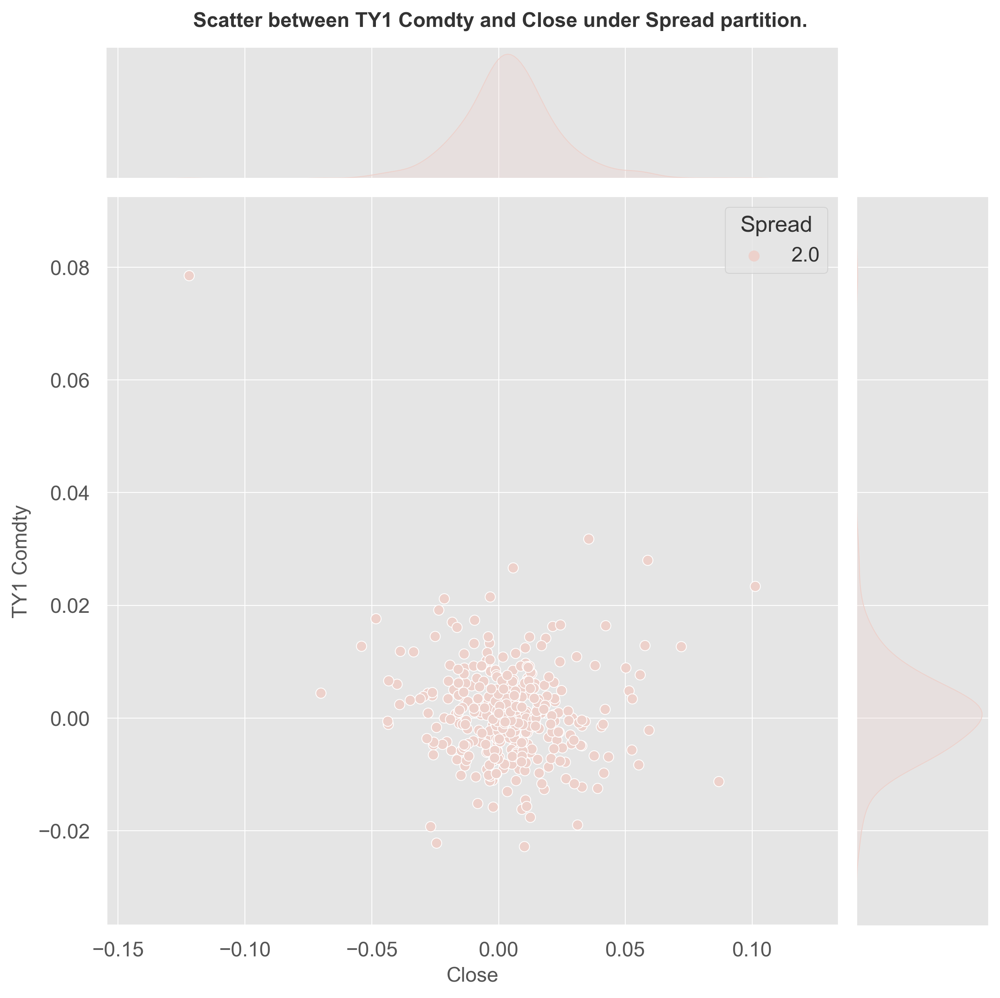

------------------------------------------------------------------------------------------------------------------------
4 | Min: 0.28 | Max: 0.64 | R^2: 0.0088 | Coef: -0.1887 | Interc.: 0.0084


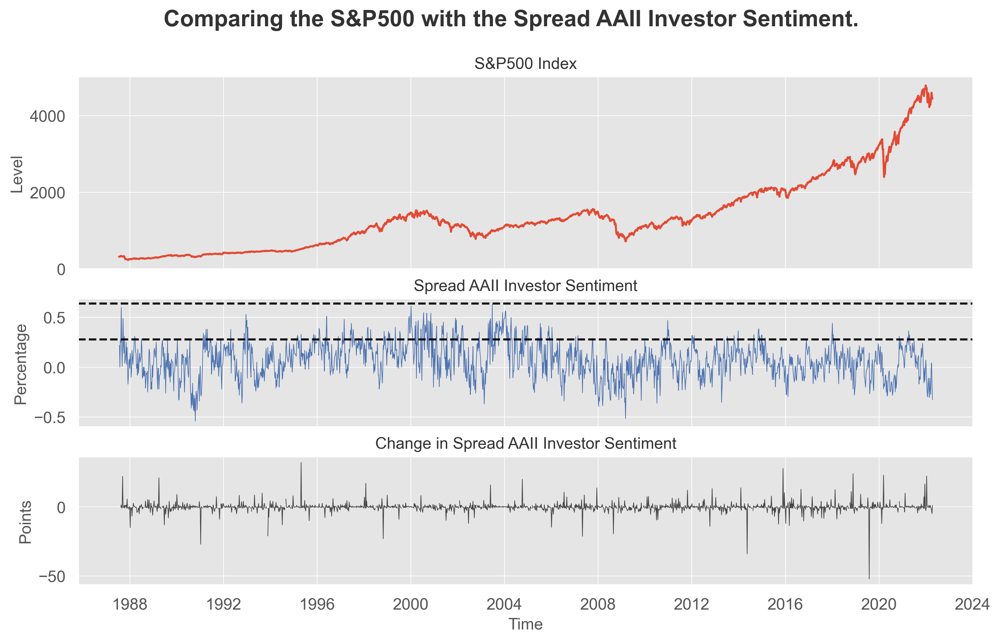

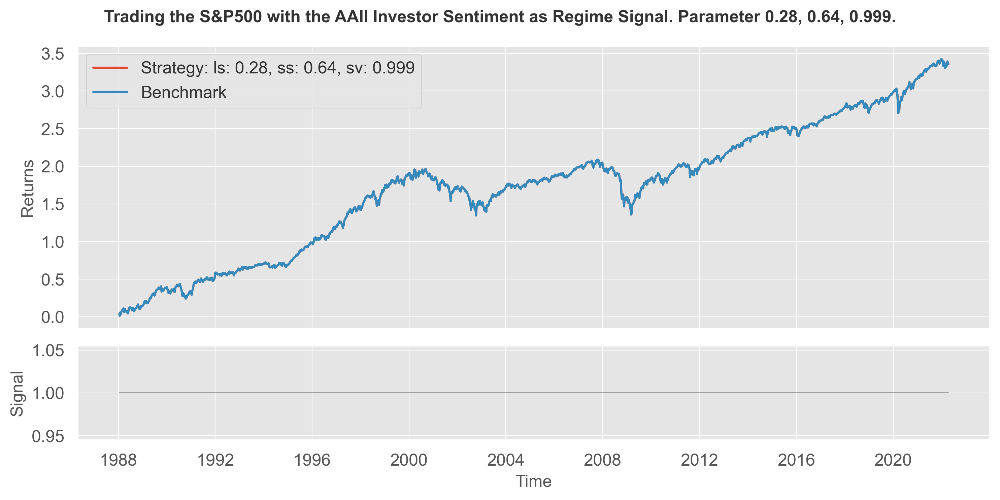

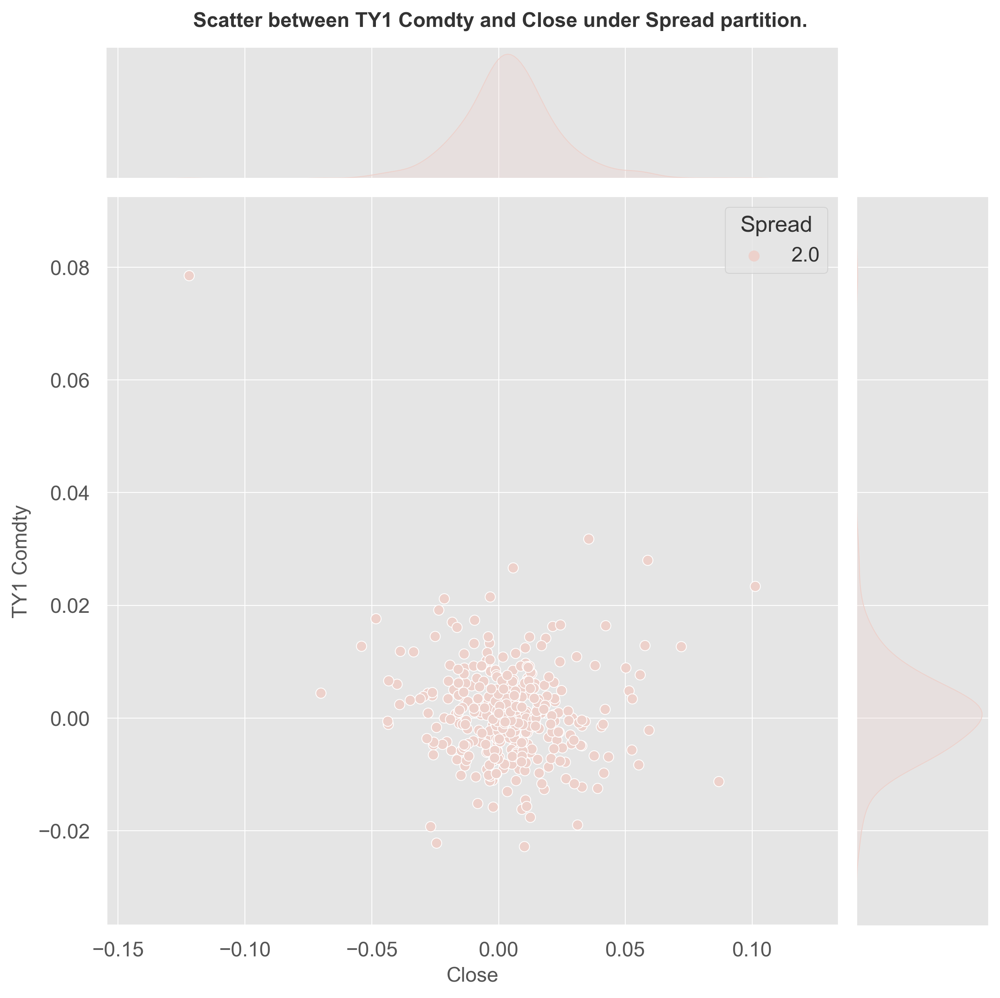

------------------------------------------------------------------------------------------------------------------------


In [32]:
# Running full analysis for variables and quantiles
# Variables
for var in ['Mov Avg', 'Spread']:
    # Quantiles
    for rank_quintile in [0, 1, 2, 3, 4]:
        
        # Regression
        _ = regressions(df=df, 
                        var1='TY1 Comdty', 
                        var2='Close', 
                        rank=var, 
                        rank_quintile=rank_quintile)
        
        # Signal plot
        sentiment_analysis2(df, 
                            var, 
                            h1 = _['Min'], 
                            h2 = _['Max'])
        
        # Backtest plot
        _ = backtest2(df['1988-01-01':], 
                      _['Min'], 
                      _['Max'], 
                      0.999, 
                      var = var, 
                      plots = True)
        
        # Scatter plot
        _ = scatter_plots(df=df, 
                      var1='TY1 Comdty', 
                      var2='Close', 
                      rank=var,
                      rank_selection=True, 
                      rank_quintile=2.0)
        
        print('-' * 120)

**Results:** No strategy outperforms based on the quintiles of the data, indicating that changing correlations are not affecting sentiment data for regime switching.

# Part 5: Conclusion

As shown in this research notebook, AAII investor sentiment data is not helpful in timing the market on the equity side. This might be due to sentiment being possibly influenced itself by market prices (momentum theory). But it could be used as an indicator to take risk of the table and being more careful on the equities side, changing asset allocations more towards bonds. 

Pitfalls of this research: While the idea is generally defendable due to its contrarian nature, the approach used in this notebook includes a certain amount of hindsight bias into the results. The performance in the actual market can be different. Also, past performance is no indicator of future performance and this research is not investment advice. Trading costs are ignored in this research, as the frequency of trading is too low that it would have meaningful impact on performance.